# Project: Wrangling and Analyze Data

*-Dorothy Kunth*

## Table of Contents
- [Introduction](#intro)
- [Import Libraries](#import)
- [Gathering Data](#gather)
   - [Downloading File Manually](#manual)
   - [Downloading File Programmatically](#programmatically)  
   - [Querying Twitter API using Tweepy library](#queryAPI)   
- [Assessing data](#assess)
   - [Quality Issues](#quality)
   - [Tidiness Issues](#tidiness)
- [Cleaning data](#clean)
   - [Issue 1 - df_1 Erroneous data types](#issue1)
   - [Issue 2 - df_1 Inaccurate dog names](#issue2)  
   - [Issue 3 - df_1 Erroneous ratings for some tweet records](#issue3)  
   - [Issue 4 - df_1 Denominator greater than 10](#issue4)
   - [Issue 5 - df_1 Rating for tweet_id 810984652412424192 is null](#issue5)
   - [Issue 6 - df_2 tweet_id datatype is integer not string](#issue6)
   - [Issue 7 - Tidiness - All dataframes can be merged into one dataframe](#issue7)
   - [Issue 8 - Records that are retweets and replies](#issue8)
   - [Issue 9 - Null or NaN values in expanded_urls column ](#issue9)
   - [Issue 10 - df_1 tweet_id 835152434251116546 is not a tweet on dog rates but on plagiarism ](#issue10)
   - [Issue 11 - df_1 tweet_id 749981277374128128 has a rating_numerator of 1776 - outlier](#issue11)
   - [Issue 12 - Tidiness - Columns related to retweets and replies should be removed. ](#issue12)
   - [Issue 13 - Tidiness - A new column for dog_stage should be created ](#issue13)
   - [Issue 14 - Tidiness - Columns for individual dog stages should be removed.](#issue14)
   - [Issue 15 - df_2 Some records have inaccurate dog breeds](#issue15)
   - [Issue 16 - Tidiness - Unnecessary columns attributed to prediction of dog breed](#issue16)
   - [Issue 17 - df_2 Some dog breeds are lower-cased and some are capitalized](#issue17)  
   - [Issue 18 - Tidiness - In the final merged dataframe, indexing has been distorted due to deletion of records and merging.](#issue18)  
- [Storing Data](#store)
- [Analyzing and Visualizing Data](#analyze)
   - [Among the four utilities/apps, Twitter for iPhone is the most commonly used by the user @dog_rates.](#insight1)
   - [Retweet and Like Stats By Dog Breeds](#insight2)
   - [Retweet and Like Stats By Dog Stages](#insight3)
   - [Top 20 Popular Dog Names](#insight4)
   - [Most Retweeted Tweet has 79515 total retweets](#insight5)
   - [Most Liked Tweet has 132810 likes](#insight6)
   - [Average ratings per dog stage are almost equally distributed](#insight7)
   - [Top 20 dog breeds with the highest average ratings](#insight8)
   - [Dog Stages Pie Chart](#insight9)
   - [Retweets and Likes Correlation per Rating](#insight10)   

<a id='intro'></a>
## Introduction


Data Wrangling is the process of gathering data from a variety of sources and in a variety of formats, assessing its quality and structure, and cleaning it before performing further tasks like analysis, visualization, or build predictive models using machine learning.

In this project, the student is tasked to wrangle WeRateDogs Twitter data to create interesting and trustworthy analyses and visualizations by using Python and its libraries.

<a id='import'></a>
## Import Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import requests
import json
import warnings
warnings.filterwarnings('ignore')

<a id='gather'></a>
## Gathering Data

<a id='manual'></a>
### Downloading File Manually
1. Directly download the WeRateDogs Twitter archive data (twitter_archive_enhanced.csv)

In [2]:
df_1 = pd.read_csv('twitter_archive_enhanced.csv')
df_1.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
0,892420643555336193,NaN,NaN,2017-08-01 16:23:56 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Phineas. He's a mystical boy. Only eve...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892420643...,13,10,Phineas,None,None,None,None
1,892177421306343426,NaN,NaN,2017-08-01 00:17:27 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Tilly. She's just checking pup on you....,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892177421...,13,10,Tilly,None,None,None,None
2,891815181378084864,NaN,NaN,2017-07-31 00:18:03 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Archie. He is a rare Norwegian Pouncin...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891815181...,12,10,Archie,None,None,None,None
3,891689557279858688,NaN,NaN,2017-07-30 15:58:51 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Darla. She commenced a snooze mid meal...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891689557...,13,10,Darla,None,None,None,None
4,891327558926688256,NaN,NaN,2017-07-29 16:00:24 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Franklin. He would like you to stop ca...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891327558...,12,10,Franklin,None,None,None,None


In [3]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   tweet_id                    2356 non-null   int64  
 1   in_reply_to_status_id       78 non-null     float64
 2   in_reply_to_user_id         78 non-null     float64
 3   timestamp                   2356 non-null   object 
 4   source                      2356 non-null   object 
 5   text                        2356 non-null   object 
 6   retweeted_status_id         181 non-null    float64
 7   retweeted_status_user_id    181 non-null    float64
 8   retweeted_status_timestamp  181 non-null    object 
 9   expanded_urls               2297 non-null   object 
 10  rating_numerator            2356 non-null   int64  
 11  rating_denominator          2356 non-null   int64  
 12  name                        2356 non-null   object 
 13  doggo                       2356 

<a id='programmatically'></a>
### Downloading File Programmatically
2. Use the Requests library to download the tweet image prediction (image_predictions.tsv)

In [4]:
url =  'https://d17h27t6h515a5.cloudfront.net/topher/2017/August/599fd2ad_image-predictions/image-predictions.tsv'
response = requests.get(url)

with open(url.split('/')[-1], mode = 'wb') as file:
    file.write(response.content)

In [5]:
df_2 = pd.read_csv('image-predictions.tsv', sep = '\t')
df_2.head()

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,666020888022790149,https://pbs.twimg.com/media/CT4udn0WwAA0aMy.jpg,1,Welsh_springer_spaniel,0.465074,True,collie,0.156665,True,Shetland_sheepdog,0.061428,True
1,666029285002620928,https://pbs.twimg.com/media/CT42GRgUYAA5iDo.jpg,1,redbone,0.506826,True,miniature_pinscher,0.074192,True,Rhodesian_ridgeback,0.072010,True
2,666033412701032449,https://pbs.twimg.com/media/CT4521TWwAEvMyu.jpg,1,German_shepherd,0.596461,True,malinois,0.138584,True,bloodhound,0.116197,True
3,666044226329800704,https://pbs.twimg.com/media/CT5Dr8HUEAA-lEu.jpg,1,Rhodesian_ridgeback,0.408143,True,redbone,0.360687,True,miniature_pinscher,0.222752,True
4,666049248165822465,https://pbs.twimg.com/media/CT5IQmsXIAAKY4A.jpg,1,miniature_pinscher,0.560311,True,Rottweiler,0.243682,True,Doberman,0.154629,True


In [6]:
df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tweet_id  2075 non-null   int64  
 1   jpg_url   2075 non-null   object 
 2   img_num   2075 non-null   int64  
 3   p1        2075 non-null   object 
 4   p1_conf   2075 non-null   float64
 5   p1_dog    2075 non-null   bool   
 6   p2        2075 non-null   object 
 7   p2_conf   2075 non-null   float64
 8   p2_dog    2075 non-null   bool   
 9   p3        2075 non-null   object 
 10  p3_conf   2075 non-null   float64
 11  p3_dog    2075 non-null   bool   
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


<a id='queryAPI'></a>
### Querying Twitter API using Tweepy library
3. Use the Tweepy library to query additional data via the Twitter API (tweet_json.txt)

In [ ]:
import tweepy
from tweepy import OAuthHandler
from timeit import default_timer as timer

# Query Twitter API for each tweet in the Twitter archive and save JSON in a text file
# These are hidden to comply with Twitter's API terms and conditions
consumer_key = 'HIDDEN'
consumer_secret = 'HIDDEN'
access_token = 'HIDDEN'
access_secret = 'HIDDEN'

auth = OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_secret)

api = tweepy.API(auth, wait_on_rate_limit=True)

# NOTE TO STUDENT WITH MOBILE VERIFICATION ISSUES:
# df_1 is a DataFrame with the twitter_archive_enhanced.csv file. You may have to
# change line 17 to match the name of your DataFrame with twitter_archive_enhanced.csv
# NOTE TO REVIEWER: this student had mobile verification issues so the following
# Twitter API code was sent to this student from a Udacity instructor
# Tweet IDs for which to gather additional data via Twitter's API
tweet_ids = df_1.tweet_id.values
len(tweet_ids)

# Query Twitter's API for JSON data for each tweet ID in the Twitter archive
count = 0
fails_dict = {}
start = timer()
# Save each tweet's returned JSON as a new line in a .txt file
with open('tweet_json.txt', 'w') as outfile:
    # This loop will likely take 20-30 minutes to run because of Twitter's rate limit
    for tweet_id in tweet_ids:
        count += 1
        print(str(count) + ": " + str(tweet_id))
        try:
            tweet = api.get_status(tweet_id, tweet_mode='extended')
            print("Success")
            json.dump(tweet._json, outfile)
            outfile.write('\n')
        except tweepy.TweepError as e:
            print("Fail")
            fails_dict[tweet_id] = e
            pass
end = timer()
print(end - start)
print(fails_dict)

In [7]:
df_list = []

with open('tweet_json.txt') as f:
    for line in f:
        data = json.loads(line)
        df_list.append({'tweet_id' : data['id_str'],
                       'retweet_count' : data['retweet_count'],
                       'favorite_count' : data['favorite_count']})
        
df_3 = pd.DataFrame(df_list, columns = ['tweet_id', 'retweet_count', 'favorite_count'])
df_3.head()

,tweet_id,retweet_count,favorite_count
0,892420643555336193,8853,39467
1,892177421306343426,6514,33819
2,891815181378084864,4328,25461
3,891689557279858688,8964,42908
4,891327558926688256,9774,41048


In [8]:
df_3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2354 entries, 0 to 2353
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   tweet_id        2354 non-null   object
 1   retweet_count   2354 non-null   int64 
 2   favorite_count  2354 non-null   int64 
dtypes: int64(2), object(1)
memory usage: 55.3+ KB


<a id='assess'></a>
## Assessing Data
In this section, detect and document at least **eight (8) quality issues and two (2) tidiness issue**. You must use **both** visual assessment
programmatic assessement to assess the data.

**Note:** pay attention to the following key points when you access the data.

* You only want original ratings (no retweets) that have images. Though there are 5000+ tweets in the dataset, not all are dog ratings and some are retweets.
* Assessing and cleaning the entire dataset completely would require a lot of time, and is not necessary to practice and demonstrate your skills in data wrangling. Therefore, the requirements of this project are only to assess and clean at least 8 quality issues and at least 2 tidiness issues in this dataset.
* The fact that the rating numerators are greater than the denominators does not need to be cleaned. This [unique rating system](http://knowyourmeme.com/memes/theyre-good-dogs-brent) is a big part of the popularity of WeRateDogs.
* You do not need to gather the tweets beyond August 1st, 2017. You can, but note that you won't be able to gather the image predictions for these tweets since you don't have access to the algorithm used.



In [9]:
df_1

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
0,892420643555336193,NaN,NaN,2017-08-01 16:23:56 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Phineas. He's a mystical boy. Only eve...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892420643...,13,10,Phineas,None,None,None,None
1,892177421306343426,NaN,NaN,2017-08-01 00:17:27 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Tilly. She's just checking pup on you....,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892177421...,13,10,Tilly,None,None,None,None
2,891815181378084864,NaN,NaN,2017-07-31 00:18:03 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Archie. He is a rare Norwegian Pouncin...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891815181...,12,10,Archie,None,None,None,None
3,891689557279858688,NaN,NaN,2017-07-30 15:58:51 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Darla. She commenced a snooze mid meal...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891689557...,13,10,Darla,None,None,None,None
4,891327558926688256,NaN,NaN,2017-07-29 16:00:24 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Franklin. He would like you to stop ca...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891327558...,12,10,Franklin,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2351,666049248165822465,NaN,NaN,2015-11-16 00:24:50 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Here we have a 1949 1st generation vulpix. Enj...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666049248...,5,10,None,None,None,None,None
2352,666044226329800704,NaN,NaN,2015-11-16 00:04:52 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is a purebred Piers Morgan. Loves to Netf...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666044226...,6,10,a,None,None,None,None
2353,666033412701032449,NaN,NaN,2015-11-15 23:21:54 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Here is a very happy pup. Big fan of well-main...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666033412...,9,10,a,None,None,None,None
2354,666029285002620928,NaN,NaN,2015-11-15 23:05:30 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is a western brown Mitsubishi terrier. Up...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666029285...,7,10,a,None,None,None,None


In [10]:
df_2

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,666020888022790149,https://pbs.twimg.com/media/CT4udn0WwAA0aMy.jpg,1,Welsh_springer_spaniel,0.465074,True,collie,0.156665,True,Shetland_sheepdog,0.061428,True
1,666029285002620928,https://pbs.twimg.com/media/CT42GRgUYAA5iDo.jpg,1,redbone,0.506826,True,miniature_pinscher,0.074192,True,Rhodesian_ridgeback,0.072010,True
2,666033412701032449,https://pbs.twimg.com/media/CT4521TWwAEvMyu.jpg,1,German_shepherd,0.596461,True,malinois,0.138584,True,bloodhound,0.116197,True
3,666044226329800704,https://pbs.twimg.com/media/CT5Dr8HUEAA-lEu.jpg,1,Rhodesian_ridgeback,0.408143,True,redbone,0.360687,True,miniature_pinscher,0.222752,True
4,666049248165822465,https://pbs.twimg.com/media/CT5IQmsXIAAKY4A.jpg,1,miniature_pinscher,0.560311,True,Rottweiler,0.243682,True,Doberman,0.154629,True
...,...,...,...,...,...,...,...,...,...,...,...,...
2070,891327558926688256,https://pbs.twimg.com/media/DF6hr6BUMAAzZgT.jpg,2,basset,0.555712,True,English_springer,0.225770,True,German_short-haired_pointer,0.175219,True
2071,891689557279858688,https://pbs.twimg.com/media/DF_q7IAWsAEuuN8.jpg,1,paper_towel,0.170278,False,Labrador_retriever,0.168086,True,spatula,0.040836,False
2072,891815181378084864,https://pbs.twimg.com/media/DGBdLU1WsAANxJ9.jpg,1,Chihuahua,0.716012,True,malamute,0.078253,True,kelpie,0.031379,True
2073,892177421306343426,https://pbs.twimg.com/media/DGGmoV4XsAAUL6n.jpg,1,Chihuahua,0.323581,True,Pekinese,0.090647,True,papillon,0.068957,True


In [11]:
df_3

,tweet_id,retweet_count,favorite_count
0,892420643555336193,8853,39467
1,892177421306343426,6514,33819
2,891815181378084864,4328,25461
3,891689557279858688,8964,42908
4,891327558926688256,9774,41048
...,...,...,...
2349,666049248165822465,41,111
2350,666044226329800704,147,311
2351,666033412701032449,47,128
2352,666029285002620928,48,132


In [12]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   tweet_id                    2356 non-null   int64  
 1   in_reply_to_status_id       78 non-null     float64
 2   in_reply_to_user_id         78 non-null     float64
 3   timestamp                   2356 non-null   object 
 4   source                      2356 non-null   object 
 5   text                        2356 non-null   object 
 6   retweeted_status_id         181 non-null    float64
 7   retweeted_status_user_id    181 non-null    float64
 8   retweeted_status_timestamp  181 non-null    object 
 9   expanded_urls               2297 non-null   object 
 10  rating_numerator            2356 non-null   int64  
 11  rating_denominator          2356 non-null   int64  
 12  name                        2356 non-null   object 
 13  doggo                       2356 

In [13]:
df_1.sample(50)

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
1109,733828123016450049,NaN,NaN,2016-05-21 01:13:53 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Terry. The harder you hug him the fart...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/733828123...,10,10,Terry,None,None,None,None
1761,678675843183484930,NaN,NaN,2015-12-20 20:38:24 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Exotic pup here. Tail long af. Throat looks sw...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/678675843...,2,10,None,None,None,None,None
431,820837357901512704,NaN,NaN,2017-01-16 03:37:31 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: This is Finn. He's wondering if...,8.192277e+17,4.196984e+09,2017-01-11 17:01:16 +0000,https://twitter.com/dog_rates/status/819227688...,12,10,Finn,None,None,None,None
634,793614319594401792,NaN,NaN,2016-11-02 00:42:53 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: When she says you're a good boy...,7.916723e+17,4.196984e+09,2016-10-27 16:06:04 +0000,https://twitter.com/dog_rates/status/791672322...,13,10,None,None,None,None,None
1979,672980819271634944,NaN,NaN,2015-12-05 03:28:25 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Extraordinary dog here. Looks large. Just a he...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/672980819...,5,10,None,None,None,None,None
2046,671520732782923777,NaN,NaN,2015-12-01 02:46:33 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Meet Alejandro. He's an extremely seductive pu...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/671520732...,10,10,Alejandro,None,None,None,None
2016,672169685991993344,NaN,NaN,2015-12-02 21:45:16 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Bradley. That is his sandwich. He carr...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/672169685...,10,10,Bradley,None,None,None,None
184,856526610513747968,8.558181e+17,4.196984e+09,2017-04-24 15:13:52 +0000,"<a href=""http://twitter.com/download/iphone"" r...","THIS IS CHARLIE, MARK. HE DID JUST WANT TO SAY...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/856526610...,14,10,None,None,None,None,None
102,872620804844003328,NaN,NaN,2017-06-08 01:06:27 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Monkey. She's supporting owners everyw...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/872620804...,13,10,Monkey,None,None,None,None
1975,672997845381865473,NaN,NaN,2015-12-05 04:36:04 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Say hello to Kenzie. She is a fluff ball. 12/1...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/672997845...,12,10,Kenzie,None,None,None,None


In [14]:
df_1[df_1['expanded_urls'].isnull()]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
30,886267009285017600,8.862664e+17,2.281182e+09,2017-07-15 16:51:35 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@NonWhiteHat @MayhewMayhem omg hello tanner yo...,NaN,NaN,NaN,NaN,12,10,None,None,None,None,None
55,881633300179243008,8.816070e+17,4.738443e+07,2017-07-02 21:58:53 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@roushfenway These are good dogs but 17/10 is ...,NaN,NaN,NaN,NaN,17,10,None,None,None,None,None
64,879674319642796034,8.795538e+17,3.105441e+09,2017-06-27 12:14:36 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@RealKentMurphy 14/10 confirmed,NaN,NaN,NaN,NaN,14,10,None,None,None,None,None
113,870726314365509632,8.707262e+17,1.648776e+07,2017-06-02 19:38:25 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@ComplicitOwl @ShopWeRateDogs &gt;10/10 is res...,NaN,NaN,NaN,NaN,10,10,None,None,None,None,None
148,863427515083354112,8.634256e+17,7.759620e+07,2017-05-13 16:15:35 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@Jack_Septic_Eye I'd need a few more pics to p...,NaN,NaN,NaN,NaN,12,10,None,None,None,None,None
179,857214891891077121,8.571567e+17,1.806710e+08,2017-04-26 12:48:51 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@Marc_IRL pixelated af 12/10,NaN,NaN,NaN,NaN,12,10,None,None,None,None,None
185,856330835276025856,NaN,NaN,2017-04-24 02:15:55 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @Jenna_Marbles: @dog_rates Thanks for ratin...,8.563302e+17,66699013.0,2017-04-24 02:13:14 +0000,NaN,14,10,None,None,None,None,None
186,856288084350160898,8.562860e+17,2.792810e+08,2017-04-23 23:26:03 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@xianmcguire @Jenna_Marbles Kardashians wouldn...,NaN,NaN,NaN,NaN,14,10,None,None,None,None,None
188,855862651834028034,8.558616e+17,1.943518e+08,2017-04-22 19:15:32 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@dhmontgomery We also gave snoop dogg a 420/10...,NaN,NaN,NaN,NaN,420,10,None,None,None,None,None
189,855860136149123072,8.558585e+17,1.361572e+07,2017-04-22 19:05:32 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@s8n You tried very hard to portray this good ...,NaN,NaN,NaN,NaN,666,10,None,None,None,None,None


In [15]:
len(df_1[df_1['expanded_urls'].isnull()])

59

In [16]:
df_1[df_1['in_reply_to_status_id'].notnull()]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
30,886267009285017600,8.862664e+17,2.281182e+09,2017-07-15 16:51:35 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@NonWhiteHat @MayhewMayhem omg hello tanner yo...,NaN,NaN,NaN,NaN,12,10,None,None,None,None,None
55,881633300179243008,8.816070e+17,4.738443e+07,2017-07-02 21:58:53 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@roushfenway These are good dogs but 17/10 is ...,NaN,NaN,NaN,NaN,17,10,None,None,None,None,None
64,879674319642796034,8.795538e+17,3.105441e+09,2017-06-27 12:14:36 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@RealKentMurphy 14/10 confirmed,NaN,NaN,NaN,NaN,14,10,None,None,None,None,None
113,870726314365509632,8.707262e+17,1.648776e+07,2017-06-02 19:38:25 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@ComplicitOwl @ShopWeRateDogs &gt;10/10 is res...,NaN,NaN,NaN,NaN,10,10,None,None,None,None,None
148,863427515083354112,8.634256e+17,7.759620e+07,2017-05-13 16:15:35 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@Jack_Septic_Eye I'd need a few more pics to p...,NaN,NaN,NaN,NaN,12,10,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2038,671550332464455680,6.715449e+17,4.196984e+09,2015-12-01 04:44:10 +0000,"<a href=""http://twitter.com/download/iphone"" r...",After 22 minutes of careful deliberation this ...,NaN,NaN,NaN,NaN,1,10,None,None,None,None,None
2149,669684865554620416,6.693544e+17,4.196984e+09,2015-11-26 01:11:28 +0000,"<a href=""http://twitter.com/download/iphone"" r...",After countless hours of research and hundreds...,NaN,NaN,NaN,NaN,11,10,None,None,None,None,None
2169,669353438988365824,6.678065e+17,4.196984e+09,2015-11-25 03:14:30 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Tessa. She is also very pleased after ...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/669353438...,10,10,Tessa,None,None,None,None
2189,668967877119254528,6.689207e+17,2.143566e+07,2015-11-24 01:42:25 +0000,"<a href=""http://twitter.com/download/iphone"" r...",12/10 good shit Bubka\n@wane15,NaN,NaN,NaN,NaN,12,10,None,None,None,None,None


In [17]:
len(df_1[df_1['in_reply_to_status_id'].notnull()])

78

In [18]:
df_1[df_1['retweeted_status_id'].notnull()]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
19,888202515573088257,NaN,NaN,2017-07-21 01:02:36 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: This is Canela. She attempted s...,8.874740e+17,4.196984e+09,2017-07-19 00:47:34 +0000,https://twitter.com/dog_rates/status/887473957...,13,10,Canela,None,None,None,None
32,886054160059072513,NaN,NaN,2017-07-15 02:45:48 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @Athletics: 12/10 #BATP https://t.co/WxwJmv...,8.860537e+17,1.960740e+07,2017-07-15 02:44:07 +0000,https://twitter.com/dog_rates/status/886053434...,12,10,None,None,None,None,None
36,885311592912609280,NaN,NaN,2017-07-13 01:35:06 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: This is Lilly. She just paralle...,8.305833e+17,4.196984e+09,2017-02-12 01:04:29 +0000,https://twitter.com/dog_rates/status/830583320...,13,10,Lilly,None,None,None,None
68,879130579576475649,NaN,NaN,2017-06-26 00:13:58 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: This is Emmy. She was adopted t...,8.780576e+17,4.196984e+09,2017-06-23 01:10:23 +0000,https://twitter.com/dog_rates/status/878057613...,14,10,Emmy,None,None,None,None
73,878404777348136964,NaN,NaN,2017-06-24 00:09:53 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: Meet Shadow. In an attempt to r...,8.782815e+17,4.196984e+09,2017-06-23 16:00:04 +0000,"https://www.gofundme.com/3yd6y1c,https://twitt...",13,10,Shadow,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1023,746521445350707200,NaN,NaN,2016-06-25 01:52:36 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: This is Shaggy. He knows exactl...,6.678667e+17,4.196984e+09,2015-11-21 00:46:50 +0000,https://twitter.com/dog_rates/status/667866724...,10,10,Shaggy,None,None,None,None
1043,743835915802583040,NaN,NaN,2016-06-17 16:01:16 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: Extremely intelligent dog here....,6.671383e+17,4.196984e+09,2015-11-19 00:32:12 +0000,https://twitter.com/dog_rates/status/667138269...,10,10,None,None,None,None,None
1242,711998809858043904,NaN,NaN,2016-03-21 19:31:59 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @twitter: @dog_rates Awesome Tweet! 12/10. ...,7.119983e+17,7.832140e+05,2016-03-21 19:29:52 +0000,https://twitter.com/twitter/status/71199827977...,12,10,None,None,None,None,None
2259,667550904950915073,NaN,NaN,2015-11-20 03:51:52 +0000,"<a href=""http://twitter.com"" rel=""nofollow"">Tw...",RT @dogratingrating: Exceptional talent. Origi...,6.675487e+17,4.296832e+09,2015-11-20 03:43:06 +0000,https://twitter.com/dogratingrating/status/667...,12,10,None,None,None,None,None


In [19]:
len(df_1[df_1['retweeted_status_id'].notnull()])

181

In [20]:
df_1.loc[(df_1['doggo'] != 'None') & (df_1['floofer'] != 'None')]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
200,854010172552949760,NaN,NaN,2017-04-17 16:34:26 +0000,"<a href=""http://twitter.com/download/iphone"" r...","At first I thought this was a shy doggo, but i...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/854010172...,11,10,None,doggo,floofer,None,None


In [21]:
df_1.loc[(df_1['doggo'] != 'None') & (df_1['pupper'] != 'None')]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
460,817777686764523521,NaN,NaN,2017-01-07 16:59:28 +0000,"<a href=""http://twitter.com/download/iphone"" r...","This is Dido. She's playing the lead role in ""...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/817777686...,13,10,Dido,doggo,None,pupper,None
531,808106460588765185,NaN,NaN,2016-12-12 00:29:28 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Here we have Burke (pupper) and Dexter (doggo)...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/808106460...,12,10,None,doggo,None,pupper,None
565,802265048156610565,7.331095e+17,4.196984e+09,2016-11-25 21:37:47 +0000,"<a href=""http://twitter.com/download/iphone"" r...","Like doggo, like pupper version 2. Both 11/10 ...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/802265048...,11,10,None,doggo,None,pupper,None
575,801115127852503040,NaN,NaN,2016-11-22 17:28:25 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Bones. He's being haunted by another d...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/801115127...,12,10,Bones,doggo,None,pupper,None
705,785639753186217984,NaN,NaN,2016-10-11 00:34:48 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Pinot. He's a sophisticated doggo. You...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/785639753...,10,10,Pinot,doggo,None,pupper,None
733,781308096455073793,NaN,NaN,2016-09-29 01:42:20 +0000,"<a href=""http://vine.co"" rel=""nofollow"">Vine -...","Pupper butt 1, Doggo 0. Both 12/10 https://t.c...",NaN,NaN,NaN,https://vine.co/v/5rgu2Law2ut,12,10,None,doggo,None,pupper,None
778,775898661951791106,NaN,NaN,2016-09-14 03:27:11 +0000,"<a href=""http://twitter.com/download/iphone"" r...","RT @dog_rates: Like father (doggo), like son (...",7.331095e+17,4.196984e+09,2016-05-19 01:38:16 +0000,https://twitter.com/dog_rates/status/733109485...,12,10,None,doggo,None,pupper,None
822,770093767776997377,NaN,NaN,2016-08-29 03:00:36 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: This is just downright precious...,7.410673e+17,4.196984e+09,2016-06-10 00:39:48 +0000,https://twitter.com/dog_rates/status/741067306...,12,10,just,doggo,None,pupper,None
889,759793422261743616,NaN,NaN,2016-07-31 16:50:42 +0000,"<a href=""http://twitter.com/download/iphone"" r...","Meet Maggie &amp; Lila. Maggie is the doggo, L...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/759793422...,12,10,Maggie,doggo,None,pupper,None
956,751583847268179968,NaN,NaN,2016-07-09 01:08:47 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Please stop sending it pictures that don't eve...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/751583847...,5,10,None,doggo,None,pupper,None


In [22]:
df_1.loc[(df_1['doggo'] != 'None') & (df_1['puppo'] != 'None')]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
191,855851453814013952,NaN,NaN,2017-04-22 18:31:02 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Here's a puppo participating in the #ScienceMa...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/855851453...,13,10,None,doggo,None,None,puppo


In [23]:
df_1.loc[(df_1['floofer'] != 'None') & (df_1['pupper'] != 'None')]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


In [24]:
df_1.loc[(df_1['floofer'] != 'None') & (df_1['puppo'] != 'None')]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


In [25]:
df_1.loc[(df_1['pupper'] != 'None') & (df_1['puppo'] != 'None')]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


In [26]:
df_1[df_1['rating_numerator'] == 0]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
315,835152434251116546,NaN,NaN,2017-02-24 15:40:31 +0000,"<a href=""http://twitter.com/download/iphone"" r...",When you're so blinded by your systematic plag...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/835152434...,0,10,None,None,None,None,None
1016,746906459439529985,7.468859e+17,4.196984e+09,2016-06-26 03:22:31 +0000,"<a href=""http://twitter.com/download/iphone"" r...","PUPDATE: can't see any. Even if I could, I cou...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/746906459...,0,10,None,None,None,None,None


In [27]:
df_1[df_1['rating_denominator'] == 0]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
313,835246439529840640,8.352460e+17,26259576.0,2017-02-24 21:54:03 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@jonnysun @Lin_Manuel ok jomny I know you're e...,NaN,NaN,NaN,NaN,960,0,None,None,None,None,None


In [28]:
df_1['rating_numerator'].value_counts()

12      558
11      464
10      461
13      351
9       158
8       102
7        55
14       54
5        37
6        32
3        19
4        17
2         9
1         9
75        2
15        2
420       2
0         2
80        1
144       1
17        1
26        1
20        1
121       1
143       1
44        1
60        1
45        1
50        1
99        1
204       1
1776      1
165       1
666       1
27        1
182       1
24        1
960       1
84        1
88        1
Name: rating_numerator, dtype: int64

In [29]:
df_1['rating_denominator'].value_counts()

10     2333
11        3
50        3
20        2
80        2
70        1
7         1
15        1
150       1
170       1
0         1
90        1
40        1
130       1
110       1
16        1
120       1
2         1
Name: rating_denominator, dtype: int64

In [30]:
df_1[df_1['rating_numerator'] > 100] 

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
188,855862651834028034,8.558616e+17,1.943518e+08,2017-04-22 19:15:32 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@dhmontgomery We also gave snoop dogg a 420/10...,NaN,NaN,NaN,NaN,420,10,None,None,None,None,None
189,855860136149123072,8.558585e+17,1.361572e+07,2017-04-22 19:05:32 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@s8n You tried very hard to portray this good ...,NaN,NaN,NaN,NaN,666,10,None,None,None,None,None
290,838150277551247360,8.381455e+17,2.195506e+07,2017-03-04 22:12:52 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@markhoppus 182/10,NaN,NaN,NaN,NaN,182,10,None,None,None,None,None
313,835246439529840640,8.352460e+17,2.625958e+07,2017-02-24 21:54:03 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@jonnysun @Lin_Manuel ok jomny I know you're e...,NaN,NaN,NaN,NaN,960,0,None,None,None,None,None
902,758467244762497024,NaN,NaN,2016-07-28 01:00:57 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Why does this never happen at my front door......,NaN,NaN,NaN,https://twitter.com/dog_rates/status/758467244...,165,150,None,None,None,None,None
979,749981277374128128,NaN,NaN,2016-07-04 15:00:45 +0000,"<a href=""https://about.twitter.com/products/tw...",This is Atticus. He's quite simply America af....,NaN,NaN,NaN,https://twitter.com/dog_rates/status/749981277...,1776,10,Atticus,None,None,None,None
1120,731156023742988288,NaN,NaN,2016-05-13 16:15:54 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Say hello to this unbelievably well behaved sq...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/731156023...,204,170,this,None,None,None,None
1634,684225744407494656,6.842229e+17,4.196984e+09,2016-01-05 04:11:44 +0000,"<a href=""http://twitter.com/download/iphone"" r...","Two sneaky puppers were not initially seen, mo...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/684225744...,143,130,None,None,None,None,None
1635,684222868335505415,NaN,NaN,2016-01-05 04:00:18 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Someone help the girl is being mugged. Several...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/684222868...,121,110,None,None,None,None,None
1779,677716515794329600,NaN,NaN,2015-12-18 05:06:23 +0000,"<a href=""http://twitter.com/download/iphone"" r...",IT'S PUPPERGEDDON. Total of 144/120 ...I think...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/677716515...,144,120,None,None,None,None,None


In [31]:
df_1[df_1['rating_numerator'] == 1776]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
979,749981277374128128,NaN,NaN,2016-07-04 15:00:45 +0000,"<a href=""https://about.twitter.com/products/tw...",This is Atticus. He's quite simply America af....,NaN,NaN,NaN,https://twitter.com/dog_rates/status/749981277...,1776,10,Atticus,None,None,None,None


In [32]:
df_1[df_1['rating_denominator'] > 10 ]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
342,832088576586297345,8.320875e+17,3.058208e+07,2017-02-16 04:45:50 +0000,"<a href=""http://twitter.com/download/iphone"" r...",@docmisterio account started on 11/15/15,NaN,NaN,NaN,NaN,11,15,None,None,None,None,None
433,820690176645140481,NaN,NaN,2017-01-15 17:52:40 +0000,"<a href=""http://twitter.com/download/iphone"" r...",The floofs have been released I repeat the flo...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/820690176...,84,70,None,None,None,None,None
784,775096608509886464,NaN,NaN,2016-09-11 22:20:06 +0000,"<a href=""http://twitter.com/download/iphone"" r...","RT @dog_rates: After so many requests, this is...",7.403732e+17,4.196984e+09,2016-06-08 02:41:38 +0000,https://twitter.com/dog_rates/status/740373189...,9,11,None,None,None,None,None
902,758467244762497024,NaN,NaN,2016-07-28 01:00:57 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Why does this never happen at my front door......,NaN,NaN,NaN,https://twitter.com/dog_rates/status/758467244...,165,150,None,None,None,None,None
1068,740373189193256964,NaN,NaN,2016-06-08 02:41:38 +0000,"<a href=""http://twitter.com/download/iphone"" r...","After so many requests, this is Bretagne. She ...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/740373189...,9,11,None,None,None,None,None
1120,731156023742988288,NaN,NaN,2016-05-13 16:15:54 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Say hello to this unbelievably well behaved sq...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/731156023...,204,170,this,None,None,None,None
1165,722974582966214656,NaN,NaN,2016-04-21 02:25:47 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Happy 4/20 from the squad! 13/10 for all https...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/722974582...,4,20,None,None,None,None,None
1202,716439118184652801,NaN,NaN,2016-04-03 01:36:11 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Bluebert. He just saw that both #Final...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/716439118...,50,50,Bluebert,None,None,None,None
1228,713900603437621249,NaN,NaN,2016-03-27 01:29:02 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Happy Saturday here's 9 puppers on a bench. 99...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/713900603...,99,90,None,None,None,None,None
1254,710658690886586372,NaN,NaN,2016-03-18 02:46:49 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Here's a brigade of puppers. All look very pre...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/710658690...,80,80,None,None,None,None,None


In [33]:
df_1[df_1['tweet_id'] == 682962037429899265]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
1662,682962037429899265,NaN,NaN,2016-01-01 16:30:13 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is Darrel. He just robbed a 7/11 and is i...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/682962037...,7,11,Darrel,None,None,None,None


In [34]:
df_1.describe()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,retweeted_status_id,retweeted_status_user_id,rating_numerator,rating_denominator
count,2.356000e+03,7.800000e+01,7.800000e+01,1.810000e+02,1.810000e+02,2356.000000,2356.000000
mean,7.427716e+17,7.455079e+17,2.014171e+16,7.720400e+17,1.241698e+16,13.126486,10.455433
std,6.856705e+16,7.582492e+16,1.252797e+17,6.236928e+16,9.599254e+16,45.876648,6.745237
min,6.660209e+17,6.658147e+17,1.185634e+07,6.661041e+17,7.832140e+05,0.000000,0.000000
25%,6.783989e+17,6.757419e+17,3.086374e+08,7.186315e+17,4.196984e+09,10.000000,10.000000
50%,7.196279e+17,7.038708e+17,4.196984e+09,7.804657e+17,4.196984e+09,11.000000,10.000000
75%,7.993373e+17,8.257804e+17,4.196984e+09,8.203146e+17,4.196984e+09,12.000000,10.000000
max,8.924206e+17,8.862664e+17,8.405479e+17,8.874740e+17,7.874618e+17,1776.000000,170.000000


In [35]:
df_1[df_1['rating_denominator'] == 170]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
1120,731156023742988288,NaN,NaN,2016-05-13 16:15:54 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Say hello to this unbelievably well behaved sq...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/731156023...,204,170,this,None,None,None,None


In [36]:
df_1['tweet_id'].nunique()

2356

In [37]:
df_1['name'].value_counts()

None          745
a              55
Charlie        12
Cooper         11
Lucy           11
             ... 
Dex             1
Ace             1
Tayzie          1
Grizzie         1
Christoper      1
Name: name, Length: 957, dtype: int64

In [38]:
df_1[df_1['name'].str.islower()]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
22,887517139158093824,NaN,NaN,2017-07-19 03:39:09 +0000,"<a href=""http://twitter.com/download/iphone"" r...",I've yet to rate a Venezuelan Hover Wiener. Th...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/887517139...,14,10,such,None,None,None,None
56,881536004380872706,NaN,NaN,2017-07-02 15:32:16 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Here is a pupper approaching maximum borkdrive...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/881536004...,14,10,a,None,None,pupper,None
118,869988702071779329,NaN,NaN,2017-05-31 18:47:24 +0000,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: We only rate dogs. This is quit...,8.591970e+17,4.196984e+09,2017-05-02 00:04:57 +0000,https://twitter.com/dog_rates/status/859196978...,12,10,quite,None,None,None,None
169,859196978902773760,NaN,NaN,2017-05-02 00:04:57 +0000,"<a href=""http://twitter.com/download/iphone"" r...",We only rate dogs. This is quite clearly a smo...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/859196978...,12,10,quite,None,None,None,None
193,855459453768019968,NaN,NaN,2017-04-21 16:33:22 +0000,"<a href=""http://twitter.com/download/iphone"" r...","Guys, we only rate dogs. This is quite clearly...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/855459453...,12,10,quite,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2349,666051853826850816,NaN,NaN,2015-11-16 00:35:11 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is an odd dog. Hard on the outside but lo...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666051853...,2,10,an,None,None,None,None
2350,666050758794694657,NaN,NaN,2015-11-16 00:30:50 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is a truly beautiful English Wilson Staff...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666050758...,10,10,a,None,None,None,None
2352,666044226329800704,NaN,NaN,2015-11-16 00:04:52 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is a purebred Piers Morgan. Loves to Netf...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666044226...,6,10,a,None,None,None,None
2353,666033412701032449,NaN,NaN,2015-11-15 23:21:54 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Here is a very happy pup. Big fan of well-main...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666033412...,9,10,a,None,None,None,None


In [39]:
df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tweet_id  2075 non-null   int64  
 1   jpg_url   2075 non-null   object 
 2   img_num   2075 non-null   int64  
 3   p1        2075 non-null   object 
 4   p1_conf   2075 non-null   float64
 5   p1_dog    2075 non-null   bool   
 6   p2        2075 non-null   object 
 7   p2_conf   2075 non-null   float64
 8   p2_dog    2075 non-null   bool   
 9   p3        2075 non-null   object 
 10  p3_conf   2075 non-null   float64
 11  p3_dog    2075 non-null   bool   
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


In [40]:
df_2.describe()

,tweet_id,img_num,p1_conf,p2_conf,p3_conf
count,2.075000e+03,2075.000000,2075.000000,2.075000e+03,2.075000e+03
mean,7.384514e+17,1.203855,0.594548,1.345886e-01,6.032417e-02
std,6.785203e+16,0.561875,0.271174,1.006657e-01,5.090593e-02
min,6.660209e+17,1.000000,0.044333,1.011300e-08,1.740170e-10
25%,6.764835e+17,1.000000,0.364412,5.388625e-02,1.622240e-02
50%,7.119988e+17,1.000000,0.588230,1.181810e-01,4.944380e-02
75%,7.932034e+17,1.000000,0.843855,1.955655e-01,9.180755e-02
max,8.924206e+17,4.000000,1.000000,4.880140e-01,2.734190e-01


In [41]:
df_2.sample(50)

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
1179,738156290900254721,https://pbs.twimg.com/media/Cj51Oj3VAAEVe4O.jpg,1,pug,0.751758,True,tub,0.110748,False,bathtub,0.104132,False
1873,845306882940190720,https://pbs.twimg.com/media/C7siH5DXkAACnDT.jpg,1,Irish_water_spaniel,0.567475,True,Labrador_retriever,0.169496,True,curly-coated_retriever,0.101518,True
342,672256522047614977,https://pbs.twimg.com/media/CVRVvRMWEAIBKOP.jpg,1,ostrich,0.999004,False,Arabian_camel,0.000512,False,llama,0.000147,False
693,684225744407494656,https://pbs.twimg.com/media/CX7br3HWsAAQ9L1.jpg,2,golden_retriever,0.203249,True,Samoyed,0.067958,True,Great_Pyrenees,0.065327,True
1198,740699697422163968,https://pbs.twimg.com/media/Ckd-bqVUkAIiyM7.jpg,1,lawn_mower,0.878863,False,swing,0.024535,False,barrow,0.019577,False
1229,745433870967832576,https://pbs.twimg.com/media/ClhQJUUWAAEVpBX.jpg,1,barrow,0.999962,False,basset,0.000014,True,wok,0.000006,False
163,668960084974809088,https://pbs.twimg.com/media/CUifpn4WUAAS5X3.jpg,1,shower_curtain,0.226309,False,Chesapeake_Bay_retriever,0.165878,True,bathtub,0.056726,False
1965,867421006826221569,https://pbs.twimg.com/media/DAmyy8FXYAIH8Ty.jpg,1,Eskimo_dog,0.616457,True,Siberian_husky,0.381330,True,malamute,0.001670,True
1158,733822306246479872,https://pbs.twimg.com/media/Ci8Pfg_UUAA2m9i.jpg,1,Lhasa,0.457356,True,Shih-Tzu,0.371282,True,Tibetan_terrier,0.048359,True
283,671138694582165504,https://pbs.twimg.com/media/CVBdFahXAAAIe5Y.jpg,1,Samoyed,0.587342,True,Great_Pyrenees,0.268952,True,Pekinese,0.090527,True


In [42]:
df_2[df_2['jpg_url'].str.contains('video') == True]

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
320,671789708968640512,https://pbs.twimg.com/tweet_video_thumb/CVKtH-...,1,dalmatian,0.114259,True,teddy,0.062275,False,steam_locomotive,0.049700,False
462,674805413498527744,https://pbs.twimg.com/ext_tw_video_thumb/67480...,1,English_springer,0.594467,True,cocker_spaniel,0.389994,True,Welsh_springer_spaniel,0.007096,True
480,675354435921575936,https://pbs.twimg.com/ext_tw_video_thumb/67535...,1,upright,0.303415,False,golden_retriever,0.181351,True,Brittany_spaniel,0.162084,True
495,675740360753160193,https://pbs.twimg.com/ext_tw_video_thumb/67574...,1,golden_retriever,0.800495,True,kuvasz,0.097756,True,Saluki,0.068415,True
528,676776431406465024,https://pbs.twimg.com/ext_tw_video_thumb/67677...,1,doormat,0.201346,False,dishwasher,0.191749,False,microwave,0.038110,False
...,...,...,...,...,...,...,...,...,...,...,...,...
2014,879415818425184262,https://pbs.twimg.com/ext_tw_video_thumb/87941...,1,English_springer,0.383404,True,Boston_bull,0.134967,True,Cardigan,0.110481,True
2023,881536004380872706,https://pbs.twimg.com/ext_tw_video_thumb/88153...,1,Samoyed,0.281463,True,Angora,0.272066,False,Persian_cat,0.114854,False
2050,887343217045368832,https://pbs.twimg.com/ext_tw_video_thumb/88734...,1,Mexican_hairless,0.330741,True,sea_lion,0.275645,False,Weimaraner,0.134203,True
2052,887517139158093824,https://pbs.twimg.com/ext_tw_video_thumb/88751...,1,limousine,0.130432,False,tow_truck,0.029175,False,shopping_cart,0.026321,False


In [43]:
df_2[df_2['tweet_id'] == 856288084350160898]

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog


In [44]:
df_2['p1'].value_counts()

golden_retriever      150
Labrador_retriever    100
Pembroke               89
Chihuahua              83
pug                    57
                     ... 
pillow                  1
carousel                1
bald_eagle              1
lorikeet                1
orange                  1
Name: p1, Length: 378, dtype: int64

In [45]:
df_2['p2'].value_counts()

Labrador_retriever    104
golden_retriever       92
Cardigan               73
Chihuahua              44
Pomeranian             42
                     ... 
medicine_chest          1
quail                   1
horse_cart              1
waffle_iron             1
bagel                   1
Name: p2, Length: 405, dtype: int64

In [46]:
df_2['p3'].value_counts()

Labrador_retriever    79
Chihuahua             58
golden_retriever      48
Eskimo_dog            38
kelpie                35
                      ..
ox                     1
assault_rifle          1
axolotl                1
pot                    1
banana                 1
Name: p3, Length: 408, dtype: int64

In [47]:
df_3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2354 entries, 0 to 2353
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   tweet_id        2354 non-null   object
 1   retweet_count   2354 non-null   int64 
 2   favorite_count  2354 non-null   int64 
dtypes: int64(2), object(1)
memory usage: 55.3+ KB


In [48]:
df_3.describe()

,retweet_count,favorite_count
count,2354.000000,2354.000000
mean,3164.797366,8080.968564
std,5284.770364,11814.771334
min,0.000000,0.000000
25%,624.500000,1415.000000
50%,1473.500000,3603.500000
75%,3652.000000,10122.250000
max,79515.000000,132810.000000


<a id='quality'></a>
### Quality Issues

### df_1 | twitter_archive_enhanced.csv

**Issue#1** - 1. Erroneous data types: tweet_id is an integer not string and timestamp is an object not datetime. 



**Issue#2** - 2. There are inaccurate dog names in name column like a, an, the, such, quite, etc. 



**Issue#3** - 3. Erroneous ratings for the following:

- tweet_id 682962037429899265 rating shows 7/11 but that pertains to a convenience store; Correct rating is 10/10. 
- tweet_id 740373189193256964 rating shows 9/11 but text says the dog was the last surviving 9/11 search dog. Correct rating is 14/10 and name of the dog is Bretagne. 
- tweet_id 722974582966214656 rating shows 4/20 but test says "happy 4/20" which refers to the day the tweet was made. Correct rating is 13/10.
- tweet_id 716439118184652801 rating shows 50/50 but text says 'He just saw that both #FinalFur match ups are split 50/50.' Correct rating is 11/10. 
- tweet_id 810984652412424192 rating shows 24/7 but text says 'Meet Sam. She smiles 24/7.' There is no rating for this dog. 
- tweet_id 666287406224695296 rating shows 1/2 but text says 'This is an Albanian 3 1/2 legged  Episcopalian.' Correct rating is 9/10.
- tweet_id 786709082849828864 rating shows 75/10 but correct rating is 9.75/10.
- tweet_id 778027034220126208 rating shows 27/10 but correct rating is 11.27/10.
- tweet_id 680494726643068929 rating shows 26/10 but correct rating is 11.26/10. They're puppers


**Issue#4** - 4. Some tweets have rating_denominator of greater than 10 which appear to be for multiple dogs and multiple ratings like tweet_ids 677716515794329600 and 731156023742988288 with ratings 144/120 and 204/170 respectively. Denominator of 120 is for 12 dogs and 170 is for 17 dogs.



**Issue#5** - 5. The dog_rating of tweet_id 810984652412424192  has become NaN due to the division of rating_numerator by rating denominator which are both zero (0/0).



**Issue#8** - 6. Records with values in retweeted_status_id, retweeted_status_user_id, retweeted_status_timestamp, in_reply_to_status_id and in_reply_to_user_id columns are retweets and replies and not original tweets that contain original rating.  



**Issue#9** - 7. There are NaN values in expanded_urls column which mostly retweets and tweets that are not about dog ratings. 



**Issue#10** - 8. tweet_id 835152434251116546 is not a tweet on dog rates but on plagiarism - have zero rating_numerator, no name, no dog stage.



**Issue#11** - 9. tweet_id 749981277374128128 has a rating_numerator of 1776 and rating numerator of 10 and this rating is only for one dog. This is considered an outlier because it differs significantly from other observations


### df_2 | image-predictions.tsv

**Issue#6** - 1. tweet_id datatype is integer not string.



**Issue#15** - 2. Some records have inaccurate dog breeds like shopping_cart, desktop_computer, box_turtle, limousine, orange, etc.



**Issue#17** - 3. Some dog breeds are lower-cased and some are capitalized.


<a id='tidiness'></a>
### Tidiness Issues

**Issue#7** - 1. All dataframes can be merged into one dataframe based on tweet_id. 



**Issue#12** - 2. Columns that are attributed to retweets and replies should be removed.



**Issue#13** - 3. A new column for dog_stage should be created where the combination of the values from the four individual dog stages (doggo, floofer, pupper and puppo) will be stored. 



**Issue#14** - 4. Columns for individual dog stages (doggo, floofer, pupper and puppo) should be removed.



**Issue#16** - 5. Columns attributed to prediction of dog breed such as img_num, p1, p1_conf, p1_dog, p2, p2_conf, p2_dog, p3, p3_conf, p3_dog should be removed once dog breed for each record has been established.



**Issue#18** - 6. In the final merged dataframe, indexing has been distorted due to deletion of records and merging.


<a id='clean'></a>
## Cleaning Data
In this section, clean **all** of the issues you documented while assessing. 

**Note:** Make a copy of the original data before cleaning. Cleaning includes merging individual pieces of data according to the rules of [tidy data](https://cran.r-project.org/web/packages/tidyr/vignettes/tidy-data.html). The result should be a high-quality and tidy master pandas DataFrame (or DataFrames, if appropriate).

In [49]:
# Make copies of original pieces of data
df_1_clean = df_1.copy()
df_2_clean = df_2.copy()
df_3_clean = df_3.copy()

<a id='issue1'></a>
### Issue#1: df_1 - Erroneous data types: tweet_id is an integer not string and timestamp is an object not datetime. 

#### Define: Convert tweet_id column to string and timestamp column to datetime pd.to_datetime().

#### Codes

In [50]:
df_1_clean['tweet_id'] = df_1_clean['tweet_id'].astype(str)

In [51]:
df_1_clean['timestamp'] = pd.to_datetime(df_1_clean['timestamp'])

#### Test

In [52]:
df_1_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype              
---  ------                      --------------  -----              
 0   tweet_id                    2356 non-null   object             
 1   in_reply_to_status_id       78 non-null     float64            
 2   in_reply_to_user_id         78 non-null     float64            
 3   timestamp                   2356 non-null   datetime64[ns, UTC]
 4   source                      2356 non-null   object             
 5   text                        2356 non-null   object             
 6   retweeted_status_id         181 non-null    float64            
 7   retweeted_status_user_id    181 non-null    float64            
 8   retweeted_status_timestamp  181 non-null    object             
 9   expanded_urls               2297 non-null   object             
 10  rating_numerator            2356 non-null   int64           

<a id='issue2'></a>
### Issue#2: df_1 - There are inaccurate dog names in name column like a, an, the, such, quite, etc.

#### Define: Replace the inaccurate names which can be identified as lower-cased with 'None'

#### Code

In [53]:
mask = df_1_clean['name'].str.islower()
column_name = 'name'
df_1_clean.loc[mask, column_name] = 'None'

#### Test

In [54]:
df_1_clean[df_1_clean['name'].str.islower()]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


In [55]:
list(df_1['name'])

['Phineas',
 'Tilly',
 'Archie',
 'Darla',
 'Franklin',
 'None',
 'Jax',
 'None',
 'Zoey',
 'Cassie',
 'Koda',
 'Bruno',
 'None',
 'Ted',
 'Stuart',
 'Oliver',
 'Jim',
 'Zeke',
 'Ralphus',
 'Canela',
 'Gerald',
 'Jeffrey',
 'such',
 'Canela',
 'None',
 'None',
 'Maya',
 'Mingus',
 'Derek',
 'Roscoe',
 'None',
 'Waffles',
 'None',
 'Jimbo',
 'Maisey',
 'None',
 'Lilly',
 'None',
 'Earl',
 'Lola',
 'Kevin',
 'None',
 'None',
 'Yogi',
 'Noah',
 'Bella',
 'Grizzwald',
 'None',
 'Rusty',
 'Gus',
 'Stanley',
 'Alfy',
 'Koko',
 'Rey',
 'Gary',
 'None',
 'a',
 'Elliot',
 'Louis',
 'None',
 'Bella',
 'Jesse',
 'None',
 'Romeo',
 'None',
 'Bailey',
 'Duddles',
 'Jack',
 'Emmy',
 'Steven',
 'Beau',
 'Snoopy',
 'None',
 'Shadow',
 'Terrance',
 'Shadow',
 'Emmy',
 'Aja',
 'None',
 'Penny',
 'Dante',
 'Nelly',
 'Ginger',
 'None',
 'Benedict',
 'Venti',
 'Goose',
 'Nugget',
 'None',
 'None',
 'Cash',
 'Coco',
 'Jed',
 'None',
 'Sebastian',
 'Walter',
 'None',
 'Sierra',
 'Sierra',
 'None',
 'None',
 

<a id='issue3'></a>
### Issue#3: df_1 - Erroneous ratings for the following tweet records:

1. tweet_id 682962037429899265 rating shows 7/11 but that pertains to a convenience store; Correct rating is 10/10. 
2. tweet_id 740373189193256964 rating shows 9/11 but text says the dog was the last surviving 9/11 search dog. Correct rating is 14/10 and name of the dog is Bretagne. 
3. tweet_id 722974582966214656 rating shows 4/20 but test says "happy 4/20" which refers to the day the tweet was made. Correct rating is 13/10.
4. tweet_id 716439118184652801 rating shows 50/50 but text says 'He just saw that both #FinalFur match ups are split 50/50.' Correct rating is 11/10. 
5. tweet_id 810984652412424192 rating shows 24/7 but text says 'Meet Sam. She smiles 24/7.' There is no rating for this dog. 
6. tweet_id 666287406224695296 rating shows 1/2 but text says 'This is an Albanian 3 1/2 legged  Episcopalian.' Correct rating is 9/10.
7. tweet_id 786709082849828864 rating shows 75/10 but correct rating is 9.75/10.
8. tweet_id 778027034220126208 rating shows 27/10 but correct rating is 11.27/10.
9. tweet_id 680494726643068929 rating shows 26/10 but correct rating is 11.26/10. They're puppers

#### Define 1: Replace the rating_numerator and rating_denominator with the correct values of 10/10 for tweet_id 682962037429899265.

#### Code

In [56]:
df_1_clean.loc[df_1_clean['tweet_id'] == '682962037429899265', 'rating_numerator'] = 10
df_1_clean.loc[df_1_clean['tweet_id'] == '682962037429899265', 'rating_denominator'] = 10

#### Test

In [57]:
df_1_clean[df_1_clean['tweet_id'] == '682962037429899265']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
1662,682962037429899265,NaN,NaN,2016-01-01 16:30:13+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Darrel. He just robbed a 7/11 and is i...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/682962037...,10,10,Darrel,None,None,None,None


#### Define 2: Replace the rating_numerator and rating_denominator with the correct values of 14/10 and enter Bretagne as value for name for tweet_id 740373189193256964.

#### Code

In [58]:
df_1_clean.loc[df_1_clean['tweet_id'] == '740373189193256964', 'rating_numerator'] = 14
df_1_clean.loc[df_1_clean['tweet_id'] == '740373189193256964', 'rating_denominator'] = 10
df_1_clean.loc[df_1_clean['tweet_id'] == '740373189193256964', 'name'] = 'Bretagne'

#### Test

In [59]:
df_1_clean.loc[df_1_clean['tweet_id'] == '740373189193256964']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
1068,740373189193256964,NaN,NaN,2016-06-08 02:41:38+00:00,"<a href=""http://twitter.com/download/iphone"" r...","After so many requests, this is Bretagne. She ...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/740373189...,14,10,Bretagne,None,None,None,None


#### Define 3: Replace the rating_numerator and rating_denominator with the correct values of 13/10 for tweet_id 722974582966214656.

#### Code

In [60]:
df_1_clean.loc[df_1_clean['tweet_id'] == '722974582966214656', 'rating_numerator'] = 13
df_1_clean.loc[df_1_clean['tweet_id'] == '722974582966214656', 'rating_denominator'] = 10

#### Test

In [61]:
df_1_clean.loc[df_1_clean['tweet_id'] == '722974582966214656']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
1165,722974582966214656,NaN,NaN,2016-04-21 02:25:47+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Happy 4/20 from the squad! 13/10 for all https...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/722974582...,13,10,None,None,None,None,None


#### Define 4: Replace the rating_numerator and rating_denominator with the correct values of 11/10 for tweet_id 716439118184652801.

#### Code

In [62]:
df_1_clean.loc[df_1_clean['tweet_id'] == '716439118184652801', 'rating_numerator'] = 11
df_1_clean.loc[df_1_clean['tweet_id'] == '716439118184652801', 'rating_denominator'] = 10

#### Test

In [63]:
df_1_clean.loc[df_1_clean['tweet_id'] == '716439118184652801']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
1202,716439118184652801,NaN,NaN,2016-04-03 01:36:11+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Bluebert. He just saw that both #Final...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/716439118...,11,10,Bluebert,None,None,None,None


#### Define 5: Replace the rating_numerator and rating_denominator with the correct values of 0/0 for tweet_id 810984652412424192.

#### Code

In [64]:
df_1_clean.loc[df_1_clean['tweet_id'] == '810984652412424192', 'rating_numerator'] = 0
df_1_clean.loc[df_1_clean['tweet_id'] == '810984652412424192', 'rating_denominator'] = 0

#### Test

In [65]:
df_1_clean.loc[df_1_clean['tweet_id'] == '810984652412424192']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
516,810984652412424192,NaN,NaN,2016-12-19 23:06:23+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Meet Sam. She smiles 24/7 &amp; secretly aspir...,NaN,NaN,NaN,"https://www.gofundme.com/sams-smile,https://tw...",0,0,Sam,None,None,None,None


#### Define 6: Replace the rating_numerator and rating_denominator with the correct values of 9/10 for tweet_id 666287406224695296.

### Code

In [66]:
df_1_clean.loc[df_1_clean['tweet_id'] == '666287406224695296', 'rating_numerator'] = 9
df_1_clean.loc[df_1_clean['tweet_id'] == '666287406224695296', 'rating_denominator'] = 10

### Test

In [67]:
df_1_clean.loc[df_1_clean['tweet_id'] == '666287406224695296']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
2335,666287406224695296,NaN,NaN,2015-11-16 16:11:11+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is an Albanian 3 1/2 legged Episcopalian...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666287406...,9,10,None,None,None,None,None


#### Define 7: Replace the rating_numerator and rating_denominator with the correct values of 9.75/10 for tweet_id 786709082849828864.

#### Code

In [68]:
df_1_clean.loc[df_1_clean['tweet_id'] == '786709082849828864', 'rating_numerator'] = 9.75
df_1_clean.loc[df_1_clean['tweet_id'] == '786709082849828864', 'rating_denominator'] = 10

#### Test

In [69]:
df_1_clean.loc[df_1_clean['tweet_id'] == '786709082849828864']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
695,786709082849828864,NaN,NaN,2016-10-13 23:23:56+00:00,"<a href=""http://twitter.com/download/iphone"" r...","This is Logan, the Chow who lived. He solemnly...",NaN,NaN,NaN,https://twitter.com/dog_rates/status/786709082...,9.75,10,Logan,None,None,None,None


#### Define 8: Replace the rating_numerator and rating_denominator with the correct values of 11.27/10 for tweet_id 778027034220126208.

#### Code

In [70]:
df_1_clean.loc[df_1_clean['tweet_id'] == '778027034220126208', 'rating_numerator'] = 11.27
df_1_clean.loc[df_1_clean['tweet_id'] == '778027034220126208', 'rating_denominator'] = 10

#### Test

In [71]:
df_1_clean.loc[df_1_clean['tweet_id'] == '778027034220126208']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
763,778027034220126208,NaN,NaN,2016-09-20 00:24:34+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Sophie. She's a Jubilant Bush Pupper. ...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/778027034...,11.27,10,Sophie,None,None,pupper,None


#### Define 9: Replace the rating_numerator and rating_denominator with the correct values of 11.26/10 and enter pupper for dog_stage for tweet_id 680494726643068929.

#### Code

In [72]:
df_1_clean.loc[df_1_clean['tweet_id'] == '680494726643068929', 'rating_numerator'] = 11.26
df_1_clean.loc[df_1_clean['tweet_id'] == '680494726643068929', 'rating_denominator'] = 10
df_1_clean.loc[df_1_clean['tweet_id'] == '680494726643068929', 'pupper'] = 'pupper'

#### Test

In [73]:
df_1_clean.loc[df_1_clean['tweet_id'] == '680494726643068929']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
1712,680494726643068929,NaN,NaN,2015-12-25 21:06:00+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here we have uncovered an entire battalion of ...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/680494726...,11.26,10,None,None,None,pupper,None


<a id='issue4'></a>
### Issue#4: df_1 - Some tweets have rating_denominator of greater than 10 which appear to be for multiple dogs and multiple ratings like tweet_ids 677716515794329600 and 731156023742988288 with ratings 144/120 and 204/170 respectively. Denominator of 120 is for 12 dogs and 170 is for 17 dogs.

#### Define: Create a new column 'dog_rating' to store the actual rating of dogs computed by dividing the values in the rating_numerator column by the values in the rating_denominator column. This new column will now standardize the ratings for each tweet.

#### Code

In [74]:
df_1_clean.insert(12, 'dog_rating', df_1_clean['rating_numerator'] / df_1_clean['rating_denominator'])

#### Test

In [75]:
df_1_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 18 columns):
 #   Column                      Non-Null Count  Dtype              
---  ------                      --------------  -----              
 0   tweet_id                    2356 non-null   object             
 1   in_reply_to_status_id       78 non-null     float64            
 2   in_reply_to_user_id         78 non-null     float64            
 3   timestamp                   2356 non-null   datetime64[ns, UTC]
 4   source                      2356 non-null   object             
 5   text                        2356 non-null   object             
 6   retweeted_status_id         181 non-null    float64            
 7   retweeted_status_user_id    181 non-null    float64            
 8   retweeted_status_timestamp  181 non-null    object             
 9   expanded_urls               2297 non-null   object             
 10  rating_numerator            2356 non-null   float64         

In [76]:
df_1_clean.sample(5)

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,doggo,floofer,pupper,puppo
1796,677301033169788928,NaN,NaN,2015-12-17 01:35:24+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Juckson. He's totally on his way to a ...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/677301033...,5.0,10,0.5,Juckson,None,None,None,None
581,800443802682937345,NaN,NaN,2016-11-20 21:00:48+00:00,"<a href=""http://twitter.com/download/iphone"" r...",RT @dog_rates: This is Sampson. He's about to ...,7.761133e+17,4.196984e+09,2016-09-14 17:40:06 +0000,https://twitter.com/dog_rates/status/776113305...,11.0,10,1.1,Sampson,None,None,pupper,None
126,868552278524837888,NaN,NaN,2017-05-27 19:39:34+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Say hello to Cooper. His expression is the sam...,NaN,NaN,NaN,"https://www.gofundme.com/3ti3nps,https://twitt...",12.0,10,1.2,Cooper,None,None,None,None
1395,699801817392291840,NaN,NaN,2016-02-17 03:45:29+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Cooper. He began to tear up when his b...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/699801817...,11.0,10,1.1,Cooper,None,None,pupper,None
2355,666020888022790149,NaN,NaN,2015-11-15 22:32:08+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here we have a Japanese Irish Setter. Lost eye...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666020888...,8.0,10,0.8,None,None,None,None,None


<a id='issue5'></a>
### Issue#5: df_1 - The dog_rating of tweet_id 810984652412424192  has become NaN due to the division of rating_numerator by rating denominator which are both zero (0/0).

In [77]:
df_1_clean[df_1_clean['dog_rating'].isnull()]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,doggo,floofer,pupper,puppo
516,810984652412424192,NaN,NaN,2016-12-19 23:06:23+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Meet Sam. She smiles 24/7 &amp; secretly aspir...,NaN,NaN,NaN,"https://www.gofundme.com/sams-smile,https://tw...",0.0,0,NaN,Sam,None,None,None,None


#### Define: Change the dog_rating to zero (0) to represent no rating.

#### Code

In [78]:
df_1_clean.loc[df_1_clean['tweet_id'] == '810984652412424192', 'dog_rating'] = 0

#### Test

In [79]:
df_1_clean[df_1_clean['tweet_id'] == '810984652412424192']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,doggo,floofer,pupper,puppo
516,810984652412424192,NaN,NaN,2016-12-19 23:06:23+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Meet Sam. She smiles 24/7 &amp; secretly aspir...,NaN,NaN,NaN,"https://www.gofundme.com/sams-smile,https://tw...",0.0,0,0.0,Sam,None,None,None,None


<a id='issue6'></a>
### Issue#6: df_2 - tweet_id datatype is integer not string

#### Define: Convert tweet_id column to string

#### Code

In [80]:
df_2_clean['tweet_id'] = df_2_clean['tweet_id'].astype(str)

#### Test

In [81]:
df_2_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tweet_id  2075 non-null   object 
 1   jpg_url   2075 non-null   object 
 2   img_num   2075 non-null   int64  
 3   p1        2075 non-null   object 
 4   p1_conf   2075 non-null   float64
 5   p1_dog    2075 non-null   bool   
 6   p2        2075 non-null   object 
 7   p2_conf   2075 non-null   float64
 8   p2_dog    2075 non-null   bool   
 9   p3        2075 non-null   object 
 10  p3_conf   2075 non-null   float64
 11  p3_dog    2075 non-null   bool   
dtypes: bool(3), float64(3), int64(1), object(5)
memory usage: 152.1+ KB


<a id='issue7'></a>
### Issue#7: Tidiness - All dataframes can be merged into one dataframe based on tweet_id.

#### Define: Merge df_1_clean, df_2_clean and df_3_clean joining on tweet_id.

#### Code

In [82]:
dog_rates_df = df_1_clean.merge(df_2_clean, on = 'tweet_id', how = 'left').merge(df_3_clean, on = 'tweet_id', how = 'left')

#### Test

In [83]:
dog_rates_df.tail()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,...,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog,retweet_count,favorite_count
2351,666049248165822465,NaN,NaN,2015-11-16 00:24:50+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here we have a 1949 1st generation vulpix. Enj...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666049248...,...,0.560311,True,Rottweiler,0.243682,True,Doberman,0.154629,True,41.0,111.0
2352,666044226329800704,NaN,NaN,2015-11-16 00:04:52+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is a purebred Piers Morgan. Loves to Netf...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666044226...,...,0.408143,True,redbone,0.360687,True,miniature_pinscher,0.222752,True,147.0,311.0
2353,666033412701032449,NaN,NaN,2015-11-15 23:21:54+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here is a very happy pup. Big fan of well-main...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666033412...,...,0.596461,True,malinois,0.138584,True,bloodhound,0.116197,True,47.0,128.0
2354,666029285002620928,NaN,NaN,2015-11-15 23:05:30+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is a western brown Mitsubishi terrier. Up...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666029285...,...,0.506826,True,miniature_pinscher,0.074192,True,Rhodesian_ridgeback,0.072010,True,48.0,132.0
2355,666020888022790149,NaN,NaN,2015-11-15 22:32:08+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here we have a Japanese Irish Setter. Lost eye...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666020888...,...,0.465074,True,collie,0.156665,True,Shetland_sheepdog,0.061428,True,532.0,2535.0


In [84]:
dog_rates_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2356 entries, 0 to 2355
Data columns (total 31 columns):
 #   Column                      Non-Null Count  Dtype              
---  ------                      --------------  -----              
 0   tweet_id                    2356 non-null   object             
 1   in_reply_to_status_id       78 non-null     float64            
 2   in_reply_to_user_id         78 non-null     float64            
 3   timestamp                   2356 non-null   datetime64[ns, UTC]
 4   source                      2356 non-null   object             
 5   text                        2356 non-null   object             
 6   retweeted_status_id         181 non-null    float64            
 7   retweeted_status_user_id    181 non-null    float64            
 8   retweeted_status_timestamp  181 non-null    object             
 9   expanded_urls               2297 non-null   object             
 10  rating_numerator            2356 non-null   float64         

<a id='issue8'></a>
### Issue#8: Records with values in retweeted_status_id, retweeted_status_user_id, retweeted_status_timestamp, in_reply_to_status_id and in_reply_to_user_id columns are retweets and replies which imply that these are not original tweets that contain original rating.

*According to [Tweet Data Dictionary](https://developer.twitter.com/en/docs/twitter-api/v1/data-dictionary/object-model/tweet), If the represented Tweet is a reply, the in_reply_to_status_id field will contain the integer representation of the original Tweet’s ID and Retweets can be distinguished from typical Tweets by the existence of a retweeted_status attribute. This attribute contains a representation of the original Tweet that was retweeted.*

#### Define: Keep only records where in_reply_to_status_id and retweeted_status_id are null.

#### Code

In [85]:
dog_rates_df = dog_rates_df[dog_rates_df['in_reply_to_status_id'].isnull()]

In [86]:
dog_rates_df = dog_rates_df[dog_rates_df['retweeted_status_id'].isnull()]

#### Test

In [87]:
dog_rates_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2097 entries, 0 to 2355
Data columns (total 31 columns):
 #   Column                      Non-Null Count  Dtype              
---  ------                      --------------  -----              
 0   tweet_id                    2097 non-null   object             
 1   in_reply_to_status_id       0 non-null      float64            
 2   in_reply_to_user_id         0 non-null      float64            
 3   timestamp                   2097 non-null   datetime64[ns, UTC]
 4   source                      2097 non-null   object             
 5   text                        2097 non-null   object             
 6   retweeted_status_id         0 non-null      float64            
 7   retweeted_status_user_id    0 non-null      float64            
 8   retweeted_status_timestamp  0 non-null      object             
 9   expanded_urls               2094 non-null   object             
 10  rating_numerator            2097 non-null   float64         

<a id='issue9'></a>
### Issue#9: There are NaN values in expanded_urls column which mostly retweets and tweets that are not about dog ratings.

*After removing those records where in_reply_to_status_id and retweeted_status_id are not null, dog_rates_df is now down to 3 records where expanded_urls are null. According to [Data dictionary: Premium v1.1](https://developer.twitter.com/en/docs/twitter-api/premium/data-dictionary/object-model/entities), expanded_url is an expanded version of display_url which links to the media display page. This means, if expanded_urls is null, then that tweet has no media or image. Since we only want ratings that have images, these records will have to be removed.*

In [88]:
dog_rates_df[dog_rates_df['expanded_urls'].isnull()]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,...,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog,retweet_count,favorite_count
375,828361771580813312,NaN,NaN,2017-02-05 21:56:51+00:00,"<a href=""http://twitter.com"" rel=""nofollow"">Tw...",Beebop and Doobert should start a band 12/10 w...,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,195.0,2408.0
707,785515384317313025,NaN,NaN,2016-10-10 16:20:36+00:00,"<a href=""http://twitter.com/download/iphone"" r...","Today, 10/10, should be National Dog Rates Day",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1477.0,6800.0
1445,696518437233913856,NaN,NaN,2016-02-08 02:18:30+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Oh my god 10/10 for every little hot dog pupper,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1887.0,4274.0


#### Define:  Keep only records where expanded_urls are not null.

#### Code

In [89]:
dog_rates_df = dog_rates_df[dog_rates_df['expanded_urls'].notnull()]

#### Test

In [90]:
dog_rates_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2094 entries, 0 to 2355
Data columns (total 31 columns):
 #   Column                      Non-Null Count  Dtype              
---  ------                      --------------  -----              
 0   tweet_id                    2094 non-null   object             
 1   in_reply_to_status_id       0 non-null      float64            
 2   in_reply_to_user_id         0 non-null      float64            
 3   timestamp                   2094 non-null   datetime64[ns, UTC]
 4   source                      2094 non-null   object             
 5   text                        2094 non-null   object             
 6   retweeted_status_id         0 non-null      float64            
 7   retweeted_status_user_id    0 non-null      float64            
 8   retweeted_status_timestamp  0 non-null      object             
 9   expanded_urls               2094 non-null   object             
 10  rating_numerator            2094 non-null   float64         

<a id='issue10'></a>
### Issue#10: tweet_id 835152434251116546 is not a tweet on dog rates but on plagiarism - have zero rating_numerator, no name, no dog stage.

#### Define:  Delete record using drop method as to keep only original tweets with dog ratings

#### Code

In [91]:
dog_rates_df = dog_rates_df.drop(dog_rates_df.index[dog_rates_df['tweet_id'] == '835152434251116546'])

#### Test

In [92]:
dog_rates_df.loc[dog_rates_df['tweet_id'] == '835152434251116546']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,...,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog,retweet_count,favorite_count


<a id='issue11'></a>
### Issue#11:  tweet_id 749981277374128128 has a rating_numerator of 1776 and rating numerator of 10 and this rating is only for one dog. This is considered an outlier because it differs significantly from other observations

#### Define: Delete record of tweet_id 749981277374128128.

#### Code

In [93]:
dog_rates_df = dog_rates_df.drop(dog_rates_df.index[dog_rates_df['tweet_id'] == '749981277374128128'])

#### Test

In [94]:
dog_rates_df.loc[dog_rates_df['tweet_id'] == '749981277374128128']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,...,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog,retweet_count,favorite_count


<a id='issue12'></a>
### Issue#12: Tidiness - Columns that are attributed to retweets and replies should be removed.

#### Define: Drop the following columns: 
- in_reply_to_status_id 
- in_reply_to_user_id
- retweeted_status_id
- retweeted_status_user_id
- retweeted_status_timestamp

#### Code

In [95]:
dog_rates_df.drop(['in_reply_to_status_id', 'in_reply_to_user_id','retweeted_status_id', 'retweeted_status_user_id', \
                 'retweeted_status_timestamp'], axis = 1, inplace = True)

#### Test

In [96]:
dog_rates_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2092 entries, 0 to 2355
Data columns (total 26 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            2092 non-null   object             
 1   timestamp           2092 non-null   datetime64[ns, UTC]
 2   source              2092 non-null   object             
 3   text                2092 non-null   object             
 4   expanded_urls       2092 non-null   object             
 5   rating_numerator    2092 non-null   float64            
 6   rating_denominator  2092 non-null   int64              
 7   dog_rating          2092 non-null   float64            
 8   name                2092 non-null   object             
 9   doggo               2092 non-null   object             
 10  floofer             2092 non-null   object             
 11  pupper              2092 non-null   object             
 12  puppo               2092 non-null 

<a id='issue13'></a>
### Issue#13: Tidiness - A new column for dog_stage should be created where the combination of the values from the four individual dog stages (doggo, floofer, pupper and puppo) will be stored. 

#### Define:  Combine the four stage columns (doggo, floofer, pupper, puppo) into one column dog_stage. All 'None' values should first be replaced with empty string to accomodate multiple dog stage like 'doggo-floofer', 'doggo-pupper', etc. Then format those with multiple dog stage with a comma separator. Then replace those with empty strings with 'None'.

#### Codes

In [97]:
# replace 'None' values with empty string
dog_rates_df['doggo'].replace('None', '', inplace = True)
dog_rates_df['floofer'].replace('None', '', inplace = True)
dog_rates_df['pupper'].replace('None', '', inplace = True)
dog_rates_df['puppo'].replace('None', '', inplace = True)

In [98]:
# combine the four columns into one column (dog_stage)
dog_rates_df['dog_stage'] = dog_rates_df['doggo'] + dog_rates_df['floofer'] + dog_rates_df['pupper'] + dog_rates_df['puppo']

In [99]:
# format those with multiple dog stage with a comma separator
dog_rates_df.loc[dog_rates_df['dog_stage'] == 'doggopupper', 'dog_stage'] = 'doggo, pupper'
dog_rates_df.loc[dog_rates_df['dog_stage'] == 'doggopuppo', 'dog_stage'] = 'doggo, puppo'
dog_rates_df.loc[dog_rates_df['dog_stage'] == 'doggofloofer', 'dog_stage'] = 'doggo, floofer'

In [100]:
# replace empty string with 'None'
dog_rates_df['dog_stage'].replace('', 'None', inplace = True)

#### Test

In [101]:
dog_rates_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2092 entries, 0 to 2355
Data columns (total 27 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            2092 non-null   object             
 1   timestamp           2092 non-null   datetime64[ns, UTC]
 2   source              2092 non-null   object             
 3   text                2092 non-null   object             
 4   expanded_urls       2092 non-null   object             
 5   rating_numerator    2092 non-null   float64            
 6   rating_denominator  2092 non-null   int64              
 7   dog_rating          2092 non-null   float64            
 8   name                2092 non-null   object             
 9   doggo               2092 non-null   object             
 10  floofer             2092 non-null   object             
 11  pupper              2092 non-null   object             
 12  puppo               2092 non-null 

In [102]:
dog_rates_df['dog_stage'].value_counts()

None              1756
pupper             221
doggo               72
puppo               23
floofer              9
doggo, pupper        9
doggo, puppo         1
doggo, floofer       1
Name: dog_stage, dtype: int64

<a id='issue14'></a>
### Issue#14: Tidiness - Columns for individual dog stages (doggo, floofer, pupper and puppo) should be removed.

#### Define: Drop the following columns:  doggo, floofer, pupper, and puppo.

#### Code

In [103]:
dog_rates_df.drop(['doggo', 'floofer', 'pupper', 'puppo'], axis = 1, inplace = True)

#### Test

In [104]:
dog_rates_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2092 entries, 0 to 2355
Data columns (total 23 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            2092 non-null   object             
 1   timestamp           2092 non-null   datetime64[ns, UTC]
 2   source              2092 non-null   object             
 3   text                2092 non-null   object             
 4   expanded_urls       2092 non-null   object             
 5   rating_numerator    2092 non-null   float64            
 6   rating_denominator  2092 non-null   int64              
 7   dog_rating          2092 non-null   float64            
 8   name                2092 non-null   object             
 9   jpg_url             1969 non-null   object             
 10  img_num             1969 non-null   float64            
 11  p1                  1969 non-null   object             
 12  p1_conf             1969 non-null 

In [105]:
dog_rates_df.sample(10)

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,jpg_url,...,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog,retweet_count,favorite_count,dog_stage
1816,676606785097199616,2015-12-15 03:36:42+00:00,"<a href=""http://twitter.com/download/iphone"" r...",*screeches for a sec and then faints* 12/10 ht...,https://twitter.com/dog_rates/status/676606785...,12.0,10,1.2,None,https://pbs.twimg.com/media/CWPKSGpWcAQN6mw.jpg,...,False,doormat,0.200411,False,malinois,0.142300,True,490.0,2039.0,None
1359,703356393781329922,2016-02-26 23:10:06+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Socks. That water pup w the super legs...,https://twitter.com/dog_rates/status/703356393...,9.0,10,0.9,Socks,https://pbs.twimg.com/media/CcLS6QKUcAAUuPa.jpg,...,True,collie,0.097364,True,English_springer,0.003037,True,429.0,2085.0,None
1991,672622327801233409,2015-12-04 03:43:54+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This lil pupper is sad because we haven't foun...,https://twitter.com/dog_rates/status/672622327...,12.0,10,1.2,None,https://pbs.twimg.com/media/CVWicBbUYAIomjC.jpg,...,True,Labrador_retriever,0.010835,True,clumber,0.008786,True,542.0,1377.0,pupper
1729,679862121895714818,2015-12-24 03:12:15+00:00,"<a href=""http://twitter.com/download/iphone"" r...","""Dammit hooman I'm jus trynna lik the fler"" 11...",https://twitter.com/dog_rates/status/679862121...,11.0,10,1.1,None,https://pbs.twimg.com/media/CW9a_h1WwAApmAy.jpg,...,True,Greater_Swiss_Mountain_dog,0.431657,True,Appenzeller,0.044208,True,706.0,2678.0,None
254,844580511645339650,2017-03-22 16:04:20+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Charlie. He wants to know if you have ...,https://twitter.com/dog_rates/status/844580511...,11.0,10,1.1,Charlie,https://pbs.twimg.com/media/C7iNfq1W0AAcbsR.jpg,...,False,dishwasher,0.032489,False,printer,0.016456,False,3533.0,17871.0,None
2043,671536543010570240,2015-12-01 03:49:23+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Reginald. He's pondering what life wou...,https://twitter.com/dog_rates/status/671536543...,9.0,10,0.9,Reginald,https://pbs.twimg.com/media/CVHG6_AWwAEJf_u.jpg,...,True,bull_mastiff,0.220617,True,French_bulldog,0.068296,True,441.0,1253.0,None
424,821522889702862852,2017-01-18 01:01:34+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Harlso. He has a really good idea but ...,https://twitter.com/dog_rates/status/821522889...,13.0,10,1.3,Harlso,https://pbs.twimg.com/media/C2aitIUXAAAG-Wi.jpg,...,True,black-and-tan_coonhound,0.136602,True,miniature_pinscher,0.087654,True,2030.0,8871.0,None
1916,674307341513269249,2015-12-08 19:19:32+00:00,"<a href=""http://vine.co"" rel=""nofollow"">Vine -...",This is life-changing. 12/10 https://t.co/SroT...,https://vine.co/v/i7nWzrenw5h,12.0,10,1.2,None,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7641.0,12129.0,None
1502,692041934689402880,2016-01-26 17:50:29+00:00,"<a href=""http://vine.co"" rel=""nofollow"">Vine -...",This is Teddy. His head is too heavy. 13/10 (v...,https://vine.co/v/iiI3wmqXYmA,13.0,10,1.3,Teddy,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1424.0,3724.0,None
1057,742150209887731712,2016-06-13 00:22:53+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Edmund. He sends stellar selfies. Cute...,https://twitter.com/dog_rates/status/742150209...,8.0,10,0.8,Edmund,https://pbs.twimg.com/media/CkylrVWWsAAiXJE.jpg,...,False,French_bulldog,0.071414,True,hog,0.062465,False,1783.0,5661.0,pupper


<a id='issue15'></a>
### Issue#15: Some records have inaccurate dog breeds like shopping_cart, desktop_computer, box_turtle, limousine, orange, etc. and 123 records don't have any dog breeds as these are not included in the image prediction.

#### Define 1: Select records where all predictions are FALSE (p1_dog, p2_dog and p3_dog) and display image of each record. Create a separate dataframe for all records that have images that are actually dogs.

#### Codes

In [106]:
# select records where predictions are all false
all_false = dog_rates_df.loc[(dog_rates_df['p1_dog'] == False) & (dog_rates_df['p2_dog'] == False) & \
                             (dog_rates_df['p3_dog'] == False)]
all_false

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,jpg_url,...,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog,retweet_count,favorite_count,dog_stage
0,892420643555336193,2017-08-01 16:23:56+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Phineas. He's a mystical boy. Only eve...,https://twitter.com/dog_rates/status/892420643...,13.0,10,1.3,Phineas,https://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg,...,False,bagel,0.085851,False,banana,0.076110,False,8853.0,39467.0,None
22,887517139158093824,2017-07-19 03:39:09+00:00,"<a href=""http://twitter.com/download/iphone"" r...",I've yet to rate a Venezuelan Hover Wiener. Th...,https://twitter.com/dog_rates/status/887517139...,14.0,10,1.4,None,https://pbs.twimg.com/ext_tw_video_thumb/88751...,...,False,tow_truck,0.029175,False,shopping_cart,0.026321,False,12082.0,46959.0,None
28,886680336477933568,2017-07-16 20:14:00+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Derek. He's late for a dog meeting. 13...,https://twitter.com/dog_rates/status/886680336...,13.0,10,1.3,Derek,https://pbs.twimg.com/media/DE4fEDzWAAAyHMM.jpg,...,False,sports_car,0.139952,False,car_wheel,0.044173,False,4610.0,22798.0,None
57,881268444196462592,2017-07-01 21:49:04+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Meet Elliot. He's a Canadian Forrest Pup. Unus...,https://twitter.com/dog_rates/status/881268444...,12.0,10,1.2,Elliot,https://pbs.twimg.com/media/DDrk-f9WAAI-WQv.jpg,...,False,Indian_elephant,0.245646,False,ibex,0.055661,False,5358.0,23501.0,None
58,880935762899988482,2017-06-30 23:47:07+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Louis. He's crossing. It's a big deal....,https://twitter.com/dog_rates/status/880935762...,13.0,10,1.3,Louis,https://pbs.twimg.com/media/DDm2Z5aXUAEDS2u.jpg,...,False,umbrella,0.115123,False,traffic_light,0.069534,False,2886.0,17346.0,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2330,666362758909284353,2015-11-16 21:10:36+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Unique dog here. Very small. Lives in containe...,https://twitter.com/dog_rates/status/666362758...,6.0,10,0.6,None,https://pbs.twimg.com/media/CT9lXGsUcAAyUFt.jpg,...,False,skunk,0.002402,False,hamster,0.000461,False,595.0,804.0,None
2334,666293911632134144,2015-11-16 16:37:02+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is a funny dog. Weird toes. Won't come do...,https://twitter.com/dog_rates/status/666293911...,3.0,10,0.3,None,https://pbs.twimg.com/media/CT8mx7KW4AEQu8N.jpg,...,False,otter,0.015250,False,great_grey_owl,0.013207,False,368.0,522.0,None
2337,666268910803644416,2015-11-16 14:57:41+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Very concerned about fellow dog trapped in com...,https://twitter.com/dog_rates/status/666268910...,10.0,10,1.0,None,https://pbs.twimg.com/media/CT8QCd1WEAADXws.jpg,...,False,desk,0.085547,False,bookcase,0.079480,False,37.0,108.0,None
2338,666104133288665088,2015-11-16 04:02:55+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Not familiar with this breed. No tail (weird)....,https://twitter.com/dog_rates/status/666104133...,1.0,10,0.1,None,https://pbs.twimg.com/media/CT56LSZWoAAlJj2.jpg,...,False,cock,0.033919,False,partridge,0.000052,False,6871.0,14765.0,None


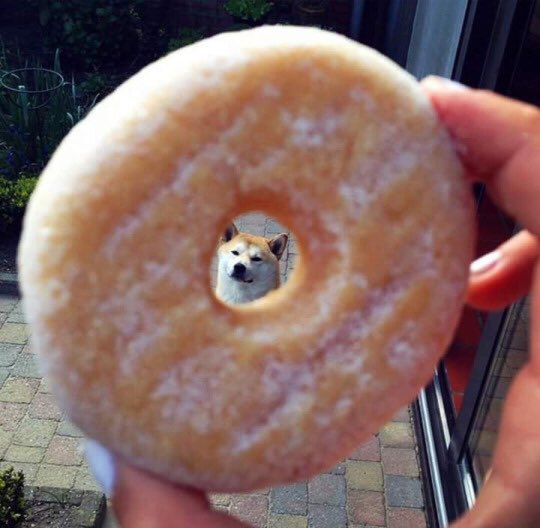

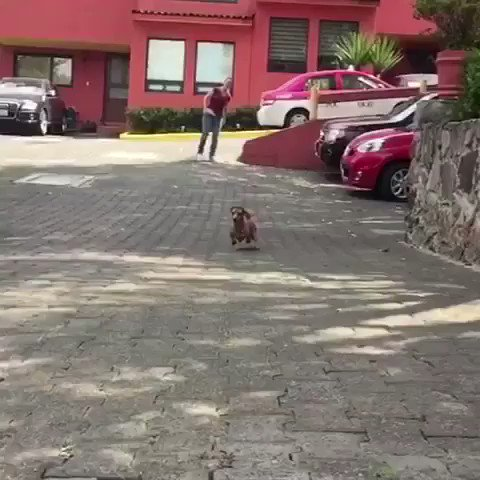

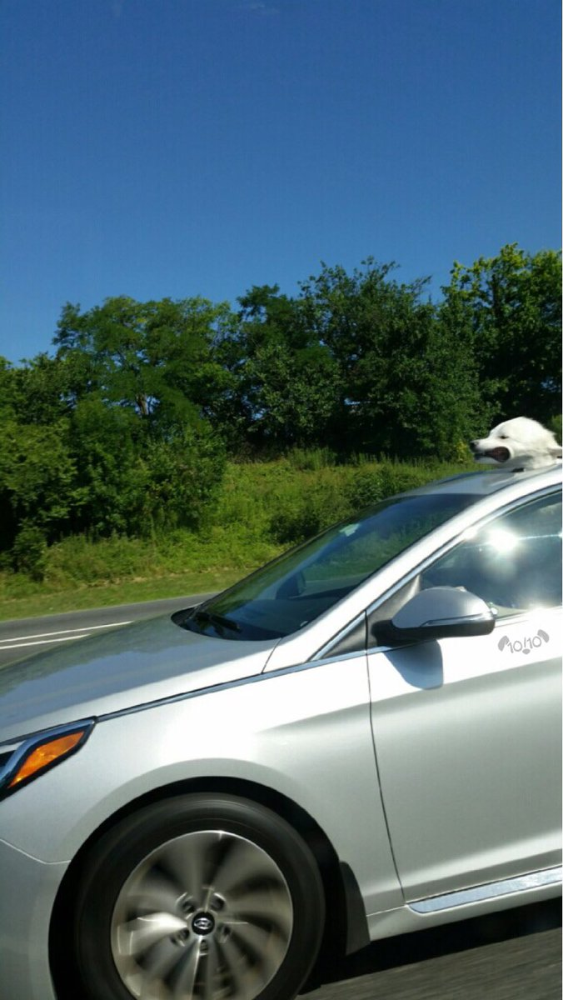

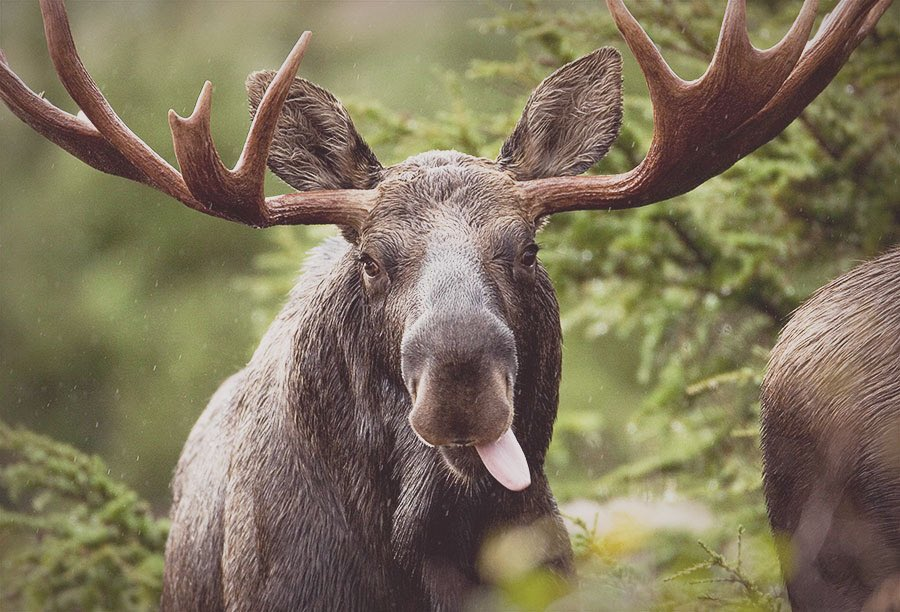

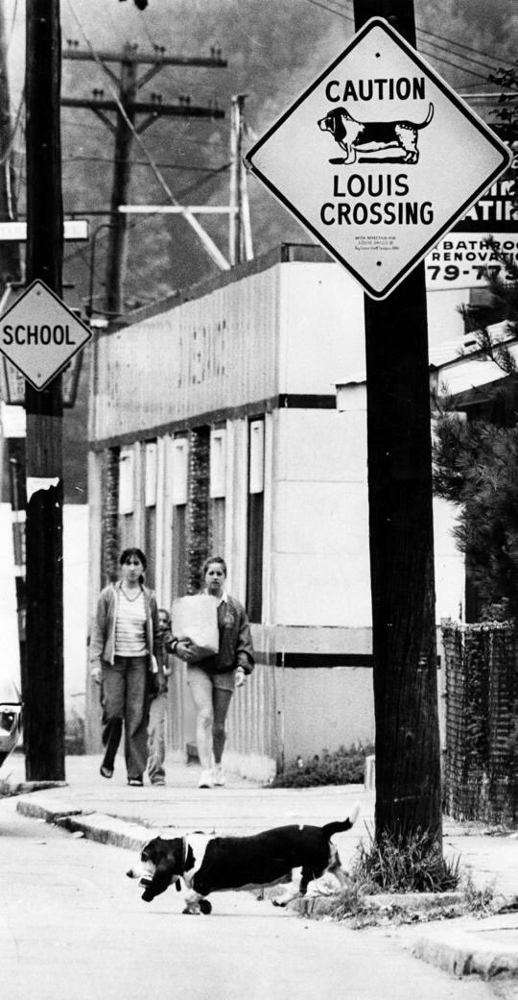

...

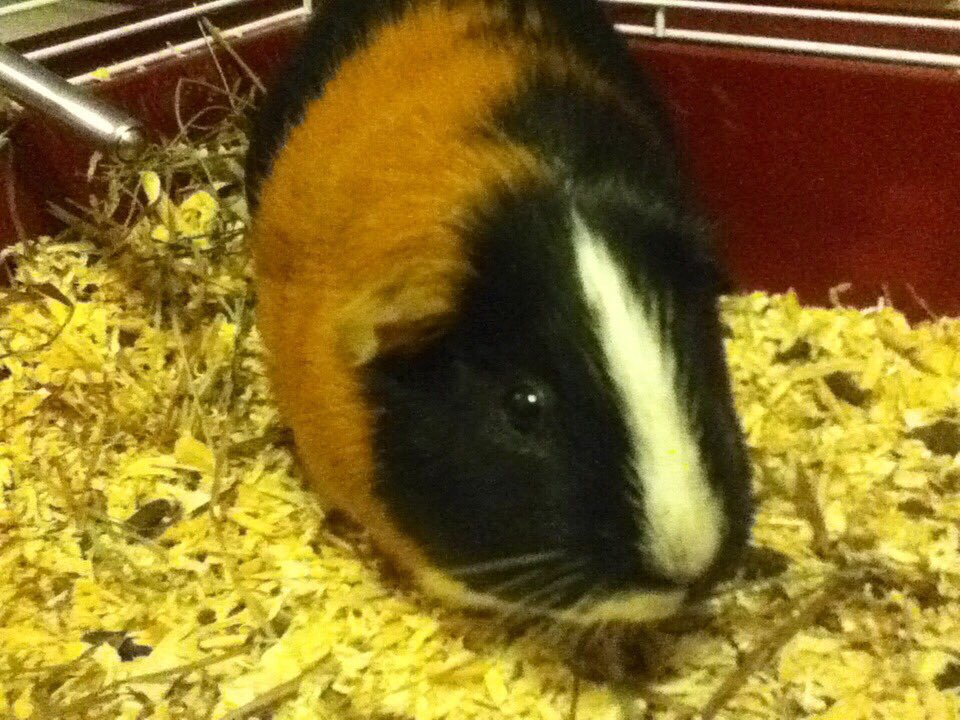

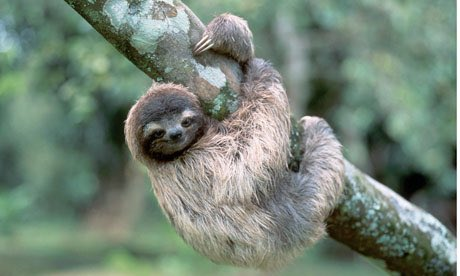

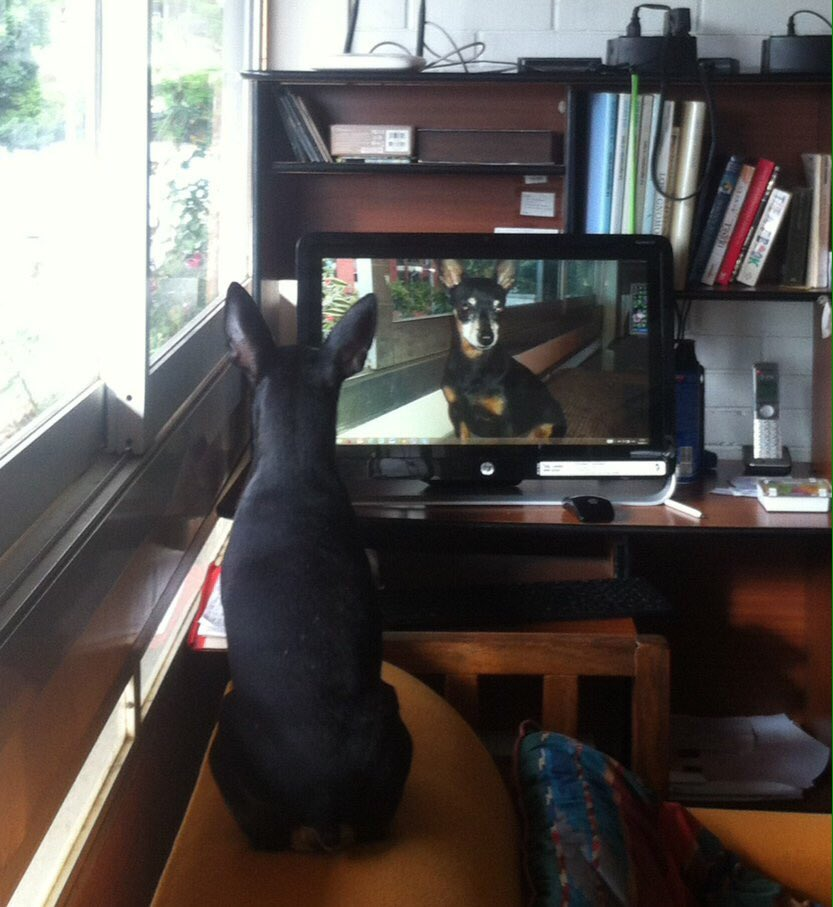

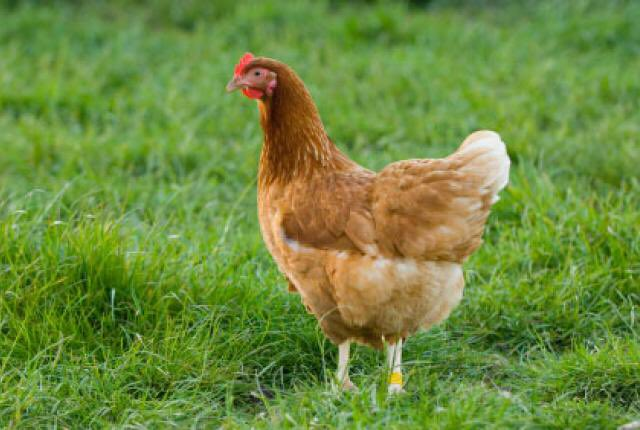

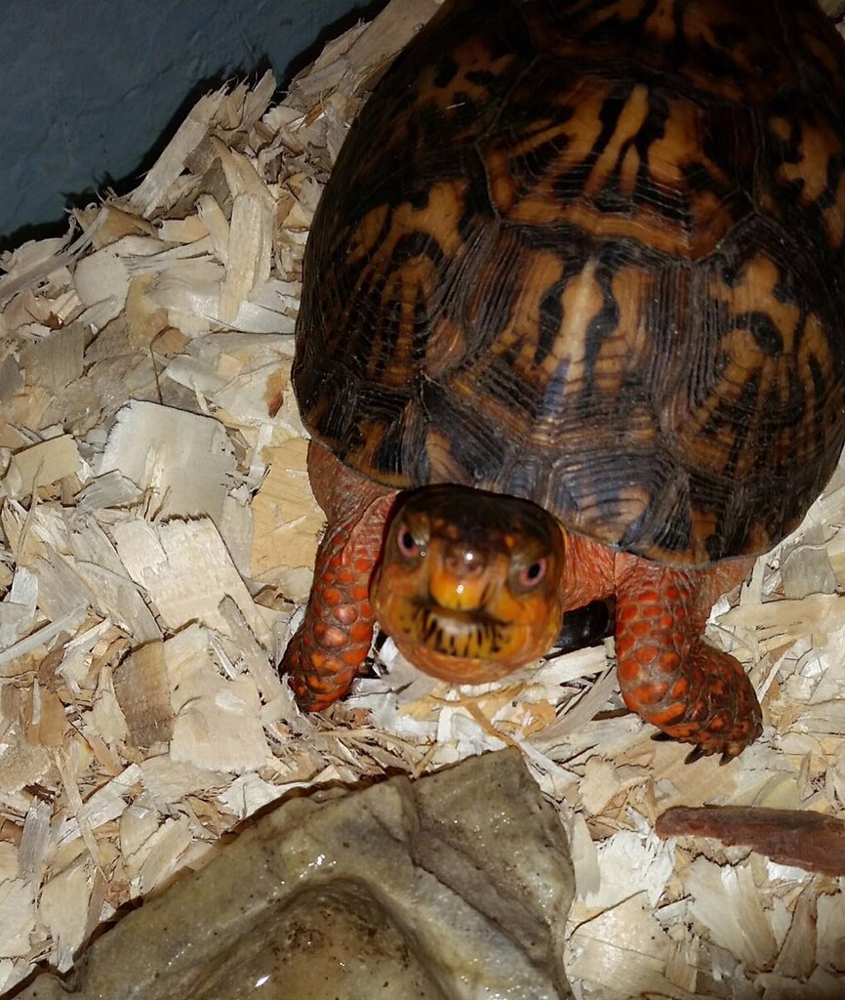

In [107]:
# display image to scan whether image represents dog or not
from IPython.core.display import display, HTML, Image
for item in all_false.index:
    row = all_false.loc[item]
    display(HTML("<b>predictions: {}, {}, {}</b> (tweet_id: {})".format(row['p1'], row['p2'], row['p3'], row.tweet_id)))
    try:
        display(Image(row.jpg_url, width = 100))
    except:
        print('Image Not Found')
    

In [108]:
# list of tweet_ids whose images are actually dogs
tweet_id_dog_list = ['666268910803644416', '666983947667116034', '667012601033924608', '667065535570550784', 
                     '667766675769573376', '667866724293877760', '668154635664932864', '668291999406125056',
                     '668544745690562560', '668620235289837568', '669214165781868544', '669351434509529089',
                     '669571471778410496', '669682095984410625', '669749430875258880', '669923323644657664',
                     '669972011175813120', '670361874861563904', '670408998013820928', '670417414769758208',
                     '670420569653809152', '670468609693655041', '670668383499735048', '671347597085433856',
                     '671362598324076544', '671497587707535361', '671547767500775424', '671874878652489728',
                     '671882082306625538', '672609152938721280', '672828477930868736', '672898206762672129',
                     '672902681409806336', '673148804208660480', '673363615379013632', '674008982932058114',
                     '674318007229923329', '674372068062928900', '674664755118911488', '674767892831932416',
                     '675113801096802304', '675153376133427200', '676776431406465024', '677228873407442944',
                     '677573743309385728', '677662372920729601', '678767140346941444', '679527802031484928',
                     '680085611152338944', '680176173301628928', '680206703334408192', '680221482581123072',
                     '680440374763077632', '680583894916304897', '681242418453299201', '681679526984871937',
                     '682047327939461121', '682059653698686977', '682242692827447297', '682697186228989953',
                     '682788441537560576', '684122891630342144', '685547936038666240', '685667379192414208',
                     '686947101016735744', '688179443353796608', '688211956440801280', '689289219123089408',
                     '689659372465688576', '690248561355657216', '690932576555528194', '690938899477221376',
                     '691090071332753408', '691820333922455552', '693486665285931008', '693647888581312512',
                     '694905863685980160', '696877980375769088', '697482927769255936', '697881462549430272',
                     '703041949650034688', '703407252292673536', '703631701117943808', '704113298707505153',
                     '706593038911545345', '707693576495472641', '707995814724026368', '711694788429553666',
                     '715360349751484417', '717790033953034240', '718454725339934721', '719704490224398336',
                     '720340705894408192', '728653952833728512', '729113531270991872', '729838605770891264',
                     '729854734790754305', '731156023742988288', '735274964362878976', '737310737551491075',
                     '737322739594330112', '740365076218183684', '740699697422163968', '742161199639494656',
                     '742465774154047488', '742528092657332225', '743510151680958465', '747204161125646336',
                     '747461612269887489', '748307329658011649', '748705597323898880', '749981277374128128',
                     '753420520834629632', '754482103782404096', '754747087846248448', '755206590534418437',
                     '757596066325864448', '760190180481531904', '760641137271070720', '761371037149827077',
                     '761672994376806400', '761745352076779520', '762035686371364864', '762316489655476224',
                     '767191397493538821', '767884188863397888', '770655142660169732', '771014301343748096',
                     '775733305207554048', '776113305656188928', '778396591732486144', '779377524342161408',
                     '780931614150983680', '781955203444699136', '783839966405230592', '788039637453406209', 
                     '792913359805018113', '793135492858580992', '794205286408003585', '795076730285391872',
                     '800018252395122689', '800443802682937345', '800459316964663297', '801285448605831168',
                     '802323869084381190', '803380650405482500', '804026241225523202', '805487436403003392',
                     '812503143955202048', '815390420867969024', '816450570814898180', '819006400881917954',
                     '819015331746349057', '819924195358416896', '820078625395449857', '824297048279236611',
                     '824796380199809024', '825876512159186944', '828046555563323392', '832769181346996225',
                     '836380477523124226', '837482249356513284', '840370681858686976', '844580511645339650',
                     '849051919805034497', '849336543269576704', '851464819735769094', '852226086759018497',
                     '852311364735569921', '864873206498414592', '870804317367881728', '886680336477933568',
                     '887517139158093824', '892420643555336193'
                    ]

In [109]:
# create a separate dataframe for records that have images which represent dogs
dog_rates_df1 = dog_rates_df[dog_rates_df['tweet_id'].isin(tweet_id_dog_list)]


In [110]:
# add column dog_breed and default value 'unknown'
dog_rates_df1['dog_breed'] = 'unknown'

#### Test 

In [111]:
dog_rates_df1.sample(10)

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,jpg_url,...,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog,retweet_count,favorite_count,dog_stage,dog_breed
548,805487436403003392,2016-12-04 19:02:24+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Meet Sansa and Gary. They run along the fence ...,https://twitter.com/dog_rates/status/805487436...,12.0,10,1.2,Sansa,https://pbs.twimg.com/media/Cy2qiTxXcAAtQBH.jpg,...,barrel,0.090180,False,sundial,0.069199,False,2929.0,9773.0,None,unknown
22,887517139158093824,2017-07-19 03:39:09+00:00,"<a href=""http://twitter.com/download/iphone"" r...",I've yet to rate a Venezuelan Hover Wiener. Th...,https://twitter.com/dog_rates/status/887517139...,14.0,10,1.4,None,https://pbs.twimg.com/ext_tw_video_thumb/88751...,...,tow_truck,0.029175,False,shopping_cart,0.026321,False,12082.0,46959.0,None,unknown
1696,681242418453299201,2015-12-27 22:37:04+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Champ. He's being sacrificed to the Az...,https://twitter.com/dog_rates/status/681242418...,10.0,10,1.0,Champ,https://pbs.twimg.com/media/CXRCXesVAAArSXt.jpg,...,rifle,0.145202,False,assault_rifle,0.097000,False,624.0,1645.0,None,unknown
1609,685547936038666240,2016-01-08 19:45:39+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Everybody needs to read this. Jack is our firs...,https://twitter.com/dog_rates/status/685547936...,14.0,10,1.4,None,https://pbs.twimg.com/media/CYOONfZW8AA7IOA.jpg,...,oscilloscope,0.009712,False,hand-held_computer,0.008769,False,17465.0,35052.0,pupper,unknown
1993,672609152938721280,2015-12-04 02:51:33+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Caryl. Likes to get in the microwave. ...,https://twitter.com/dog_rates/status/672609152...,9.0,10,0.9,Caryl,https://pbs.twimg.com/media/CVWWdKLWEAEnSk7.jpg,...,rotisserie,0.007472,False,television,0.005881,False,424.0,1180.0,None,unknown
1211,715360349751484417,2016-03-31 02:09:32+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Bertson. He just wants to say hi. 11/1...,https://twitter.com/dog_rates/status/715360349...,11.0,10,1.1,Bertson,https://pbs.twimg.com/media/Ce14cOvWwAAcFJH.jpg,...,screw,0.073277,False,padlock,0.023970,False,1772.0,5955.0,None,unknown
998,748307329658011649,2016-06-30 00:09:04+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This sherk must've leapt out of the water and ...,https://twitter.com/dog_rates/status/748307329...,7.0,10,0.7,None,https://pbs.twimg.com/media/CmKFi-FXEAAeI37.jpg,...,shovel,0.038062,False,mountain_tent,0.029203,False,810.0,4027.0,None,unknown
1960,673363615379013632,2015-12-06 04:49:31+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This little pupper can't wait for Christmas. H...,https://twitter.com/dog_rates/status/673363615...,11.0,10,1.1,None,https://pbs.twimg.com/media/CVhEoq4WcAE8pBm.jpg,...,warthog,0.123827,False,bison,0.111177,False,338.0,1088.0,pupper,unknown
472,816450570814898180,2017-01-04 01:05:59+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Meet Moose. He doesn't want his friend to go b...,https://twitter.com/dog_rates/status/816450570...,13.0,10,1.3,Moose,https://pbs.twimg.com/media/C1SddosXUAQcVR1.jpg,...,envelope,0.060107,False,nail,0.031291,False,9366.0,33961.0,None,unknown
647,793135492858580992,2016-10-31 17:00:11+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Your favorite squad is looking extra h*ckin sp...,https://twitter.com/dog_rates/status/793135492...,13.0,10,1.3,None,https://pbs.twimg.com/media/CwHIg61WIAApnEV.jpg,...,saltshaker,0.052396,False,teddy,0.046593,False,2893.0,7214.0,None,unknown


In [112]:
dog_rates_df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 166 entries, 0 to 2337
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            166 non-null    object             
 1   timestamp           166 non-null    datetime64[ns, UTC]
 2   source              166 non-null    object             
 3   text                166 non-null    object             
 4   expanded_urls       166 non-null    object             
 5   rating_numerator    166 non-null    float64            
 6   rating_denominator  166 non-null    int64              
 7   dog_rating          166 non-null    float64            
 8   name                166 non-null    object             
 9   jpg_url             166 non-null    object             
 10  img_num             166 non-null    float64            
 11  p1                  166 non-null    object             
 12  p1_conf             166 non-null   

#### Define 2: Select records where one of the predictions is TRUE (p1_dog, p2_dog and p3_dog). Create a new dataframe with a new column dog_breed and store the corresponding dog breed based on highest confidence.

#### Codes

In [113]:
# select records where one of the predictions is true
dog_rates_df2 = dog_rates_df.loc[(dog_rates_df['p1_dog'] == True) | (dog_rates_df['p2_dog'] == True) | \
                                 (dog_rates_df['p3_dog'] == True)]

In [114]:
# for loop to create a new column dog_breed and store the corresponding dog breed based on highest confidence
dog_rates_df2['dog_breed'] = 'None'

for i, row in dog_rates_df2.iterrows():
    if row.p1_dog:
        dog_rates_df2.at[i, 'dog_breed'] = row.p1
    elif row.p2_dog:
        dog_rates_df2.at[i, 'dog_breed'] = row.p2
    elif row.p3_dog:
        dog_rates_df2.at[i, 'dog_breed'] = row.p3

#### Test

In [115]:
dog_rates_df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1665 entries, 1 to 2355
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            1665 non-null   object             
 1   timestamp           1665 non-null   datetime64[ns, UTC]
 2   source              1665 non-null   object             
 3   text                1665 non-null   object             
 4   expanded_urls       1665 non-null   object             
 5   rating_numerator    1665 non-null   float64            
 6   rating_denominator  1665 non-null   int64              
 7   dog_rating          1665 non-null   float64            
 8   name                1665 non-null   object             
 9   jpg_url             1665 non-null   object             
 10  img_num             1665 non-null   float64            
 11  p1                  1665 non-null   object             
 12  p1_conf             1665 non-null 

In [116]:
pd.set_option('display.max_columns', None)
dog_rates_df2.loc[(dog_rates_df2['p1_dog'] == False) | (dog_rates_df2['p2_dog'] == False) | \
                                 (dog_rates_df2['p3_dog'] == False)]

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog,retweet_count,favorite_count,dog_stage,dog_breed
3,891689557279858688,2017-07-30 15:58:51+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Darla. She commenced a snooze mid meal...,https://twitter.com/dog_rates/status/891689557...,13.0,10,1.3,Darla,https://pbs.twimg.com/media/DF_q7IAWsAEuuN8.jpg,1.0,paper_towel,0.170278,False,Labrador_retriever,0.168086,True,spatula,0.040836,False,8964.0,42908.0,None,Labrador_retriever
5,891087950875897856,2017-07-29 00:08:17+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here we have a majestic great white breaching ...,https://twitter.com/dog_rates/status/891087950...,13.0,10,1.3,None,https://pbs.twimg.com/media/DF3HwyEWsAABqE6.jpg,1.0,Chesapeake_Bay_retriever,0.425595,True,Irish_terrier,0.116317,True,Indian_elephant,0.076902,False,3261.0,20562.0,None,Chesapeake_Bay_retriever
6,890971913173991426,2017-07-28 16:27:12+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Meet Jax. He enjoys ice cream so much he gets ...,"https://gofundme.com/ydvmve-surgery-for-jax,ht...",13.0,10,1.3,Jax,https://pbs.twimg.com/media/DF1eOmZXUAALUcq.jpg,1.0,Appenzeller,0.341703,True,Border_collie,0.199287,True,ice_lolly,0.193548,False,2158.0,12041.0,None,Appenzeller
11,889880896479866881,2017-07-25 16:11:53+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Bruno. He is a service shark. Only get...,https://twitter.com/dog_rates/status/889880896...,13.0,10,1.3,Bruno,https://pbs.twimg.com/media/DFl99B1WsAITKsg.jpg,1.0,French_bulldog,0.377417,True,Labrador_retriever,0.151317,True,muzzle,0.082981,False,5156.0,28268.0,None,French_bulldog
24,887343217045368832,2017-07-18 16:08:03+00:00,"<a href=""http://twitter.com/download/iphone"" r...",You may not have known you needed to see this ...,https://twitter.com/dog_rates/status/887343217...,13.0,10,1.3,None,https://pbs.twimg.com/ext_tw_video_thumb/88734...,1.0,Mexican_hairless,0.330741,True,sea_lion,0.275645,False,Weimaraner,0.134203,True,10737.0,34222.0,None,Mexican_hairless
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2321,666435652385423360,2015-11-17 02:00:15+00:00,"<a href=""http://twitter.com/download/iphone"" r...","""Can you behave? You're ruining my wedding day...",https://twitter.com/dog_rates/status/666435652...,10.0,10,1.0,None,https://pbs.twimg.com/media/CT-nsTQWEAEkyDn.jpg,1.0,Chesapeake_Bay_retriever,0.184130,True,chain_saw,0.056775,False,power_drill,0.036763,False,54.0,170.0,None,Chesapeake_Bay_retriever
2322,666430724426358785,2015-11-17 01:40:41+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Oh boy what a pup! Sunglasses take this one to...,https://twitter.com/dog_rates/status/666430724...,6.0,10,0.6,None,https://pbs.twimg.com/media/CT-jNYqW4AAPi2M.jpg,1.0,llama,0.505184,False,Irish_terrier,0.104109,True,dingo,0.062071,False,204.0,330.0,None,Irish_terrier
2333,666337882303524864,2015-11-16 19:31:45+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is an extremely rare horned Parthenon. No...,https://twitter.com/dog_rates/status/666337882...,9.0,10,0.9,None,https://pbs.twimg.com/media/CT9OwFIWEAMuRje.jpg,1.0,ox,0.416669,False,Newfoundland,0.278407,True,groenendael,0.102643,True,96.0,204.0,None,Newfoundland
2347,666057090499244032,2015-11-16 00:55:59+00:00,"<a href=""http://twitter.com/download/iphone"" r...",My oh my. This is a rare blond Canadian terrie...,https://twitter.com/dog_rates/status/666057090...,9.0,10,0.9,None,https://pbs.twimg.com/media/CT5PY90WoAAQGLo.jpg,1.0,shopping_cart,0.962465,False,shopping_basket,0.014594,False,golden_retriever,0.007959,True,146.0,304.0,None,golden_retriever


#### Define 3: Select records where jpg_url is null to capture the 123 records that are not included in the image prediction. Store it in a new dataframe, add a new column dog_breed with default value 'unknown'

#### Code

In [117]:
dog_rates_df3 = dog_rates_df[dog_rates_df['jpg_url'].isnull()]

In [118]:
dog_rates_df3['dog_breed'] = 'unknown'

#### Test

In [119]:
dog_rates_df3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 123 entries, 35 to 2212
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            123 non-null    object             
 1   timestamp           123 non-null    datetime64[ns, UTC]
 2   source              123 non-null    object             
 3   text                123 non-null    object             
 4   expanded_urls       123 non-null    object             
 5   rating_numerator    123 non-null    float64            
 6   rating_denominator  123 non-null    int64              
 7   dog_rating          123 non-null    float64            
 8   name                123 non-null    object             
 9   jpg_url             0 non-null      object             
 10  img_num             0 non-null      float64            
 11  p1                  0 non-null      object             
 12  p1_conf             0 non-null    

In [120]:
dog_rates_df3.sample(5)

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog,retweet_count,favorite_count,dog_stage,dog_breed
404,824025158776213504,2017-01-24 22:44:42+00:00,"<a href=""http://twitter.com/download/iphone"" r...","""I wish we were dogs"" 14/10 for @BadlandsNPS h...",https://twitter.com/badlandsnps/status/8239662...,14.0,10,1.4,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,679.0,5255.0,None,unknown
1549,689255633275777024,2016-01-19 01:18:43+00:00,"<a href=""http://vine.co"" rel=""nofollow"">Vine -...",This is Ferg. He swallowed a chainsaw. 1 like ...,https://vine.co/v/iOL792n5hz2,10.0,10,1.0,Ferg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1212.0,2805.0,None,unknown
1349,704134088924532736,2016-02-29 02:40:23+00:00,"<a href=""http://vine.co"" rel=""nofollow"">Vine -...",This sneezy pupper is just adorable af. 12/10 ...,https://vine.co/v/igW2OEwu9vg,12.0,10,1.2,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,519.0,1653.0,pupper,unknown
951,751950017322246144,2016-07-10 01:23:49+00:00,"<a href=""http://vine.co"" rel=""nofollow"">Vine -...",This is Lola. She's a surfing pupper. 13/10 ma...,https://vine.co/v/5WrjaYAMvMO,13.0,10,1.3,Lola,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1060.0,3415.0,pupper,unknown
754,778764940568104960,2016-09-22 01:16:45+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Oh my god it's Narcos but Barkos. 13/10 someon...,https://m.youtube.com/watch?v=idKxCMsS3FQ&feat...,13.0,10,1.3,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,426.0,955.0,None,unknown


#### Define 4: Join the 3 dataframes: dog_rates_df1, dog_rates_df2 and dog_rates_df3

#### Code

In [121]:
dog_rates_final = pd.concat([dog_rates_df1, dog_rates_df2, dog_rates_df3])

#### Test

In [122]:
dog_rates_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1954 entries, 0 to 2212
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            1954 non-null   object             
 1   timestamp           1954 non-null   datetime64[ns, UTC]
 2   source              1954 non-null   object             
 3   text                1954 non-null   object             
 4   expanded_urls       1954 non-null   object             
 5   rating_numerator    1954 non-null   float64            
 6   rating_denominator  1954 non-null   int64              
 7   dog_rating          1954 non-null   float64            
 8   name                1954 non-null   object             
 9   jpg_url             1831 non-null   object             
 10  img_num             1831 non-null   float64            
 11  p1                  1831 non-null   object             
 12  p1_conf             1831 non-null 

<a id='issue16'></a>
### Issue#16: Tidiness - Columns attributed to prediction of dog breed such as img_num, p1, p1_conf, p1_dog, p2, p2_conf, p2_dog, p3, p3_conf, p3_dog should be removed once dog breed for each record has been established.

#### Define: Delete columns attributed to prediction of dog breed: 
- img_num 
- p1
- p1_conf
- p1_dog
- p2
- p2_conf
- p2_dog
- p3
- p3_conf
- p3_dog


#### Code

In [123]:
dog_rates_final.drop(['img_num', 'p1', 'p1_conf', 'p1_dog', 'p2', 'p2_conf', 'p2_dog', \
                      'p3', 'p3_conf', 'p3_dog'], axis = 1, inplace = True)

#### Test

In [124]:
dog_rates_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1954 entries, 0 to 2212
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            1954 non-null   object             
 1   timestamp           1954 non-null   datetime64[ns, UTC]
 2   source              1954 non-null   object             
 3   text                1954 non-null   object             
 4   expanded_urls       1954 non-null   object             
 5   rating_numerator    1954 non-null   float64            
 6   rating_denominator  1954 non-null   int64              
 7   dog_rating          1954 non-null   float64            
 8   name                1954 non-null   object             
 9   jpg_url             1831 non-null   object             
 10  retweet_count       1954 non-null   float64            
 11  favorite_count      1954 non-null   float64            
 12  dog_stage           1954 non-null 

In [125]:
dog_rates_final.sample(10)

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,jpg_url,retweet_count,favorite_count,dog_stage,dog_breed
1038,744334592493166593,2016-06-19 01:02:50+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Blanket. She has overthrown her human....,https://twitter.com/dog_rates/status/744334592...,11.0,10,1.1,Blanket,https://pbs.twimg.com/media/ClRoXGwWIAEVVzc.jpg,2412.0,7443.0,None,Samoyed
1204,716080869887381504,2016-04-02 01:52:38+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here's a super majestic doggo and a sunset 11/...,https://twitter.com/dog_rates/status/716080869...,11.0,10,1.1,None,https://pbs.twimg.com/media/CfAHv83UMAIEQYx.jpg,1935.0,5272.0,doggo,golden_retriever
1261,710153181850935296,2016-03-16 17:18:07+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Lacy. She's tipping her hat to you. Da...,https://twitter.com/dog_rates/status/710153181...,11.0,10,1.1,Lacy,https://pbs.twimg.com/media/Cdr4jO2UAAAIo6W.jpg,1006.0,3153.0,None,cocker_spaniel
920,756303284449767430,2016-07-22 01:42:09+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Pwease accept dis rose on behalf of dog. 11/10...,https://twitter.com/dog_rates/status/756303284...,11.0,10,1.1,None,https://pbs.twimg.com/media/Cn7tyyZWYAAPlAY.jpg,1231.0,4359.0,None,golden_retriever
1130,729113531270991872,2016-05-08 00:59:46+00:00,"<a href=""http://twitter.com/download/iphone"" r...","""Challenge accepted""\n10/10 https://t.co/vNjvr...",https://twitter.com/dog_rates/status/729113531...,10.0,10,1.0,None,https://pbs.twimg.com/media/Ch5U4FzXEAAShhF.jpg,370.0,2054.0,None,unknown
932,754011816964026368,2016-07-15 17:56:40+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Charlie. He pouts until he gets to go ...,https://twitter.com/dog_rates/status/754011816...,12.0,10,1.2,Charlie,https://pbs.twimg.com/media/CnbJuPoXEAAjcVF.jpg,4079.0,9726.0,None,French_bulldog
418,822462944365645825,2017-01-20 15:17:01+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Gabe. He was the unequivocal embodimen...,https://twitter.com/dog_rates/status/822462944...,14.0,10,1.4,Gabe,https://pbs.twimg.com/media/C2n5rUUXEAIXAtv.jpg,17209.0,31800.0,pupper,Pomeranian
1742,679462823135686656,2015-12-23 00:45:35+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Meet Hurley. He's the curly one. He hugs every...,https://twitter.com/dog_rates/status/679462823...,11.0,10,1.1,Hurley,https://pbs.twimg.com/media/CW3v1KxW8AAIOuy.jpg,21324.0,34856.0,None,toy_poodle
1783,677673981332312066,2015-12-18 02:17:22+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Endangered triangular pup here. Could be a wiz...,https://twitter.com/dog_rates/status/677673981...,9.0,10,0.9,None,https://pbs.twimg.com/media/CWeU5LBWEAA8F0J.jpg,1677.0,3603.0,None,Maltese_dog
2024,671891728106971137,2015-12-02 03:20:45+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Mojo. Apparently he's too cute for a s...,https://twitter.com/dog_rates/status/671891728...,11.0,10,1.1,Mojo,https://pbs.twimg.com/media/CVMJ9guXAAAhAiK.jpg,618.0,1415.0,None,Labrador_retriever


<a id='issue17'></a>
### Issue#17: Some dog breeds are lower-cased and some are capitalized

#### Define: Capitalize the first character of dog breeds

#### Code

In [126]:
dog_rates_final['dog_breed'] = dog_rates_final['dog_breed'].str.capitalize()

#### Test

In [127]:
dog_rates_final['dog_breed'].value_counts()

Unknown               289
Golden_retriever      156
Labrador_retriever    106
Pembroke               94
Chihuahua              90
                     ... 
Entlebucher             1
Japanese_spaniel        1
Standard_schnauzer      1
Silky_terrier           1
Irish_wolfhound         1
Name: dog_breed, Length: 114, dtype: int64

In [128]:
dog_rates_final.head()

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,jpg_url,retweet_count,favorite_count,dog_stage,dog_breed
0,892420643555336193,2017-08-01 16:23:56+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Phineas. He's a mystical boy. Only eve...,https://twitter.com/dog_rates/status/892420643...,13.0,10,1.3,Phineas,https://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg,8853.0,39467.0,None,Unknown
22,887517139158093824,2017-07-19 03:39:09+00:00,"<a href=""http://twitter.com/download/iphone"" r...",I've yet to rate a Venezuelan Hover Wiener. Th...,https://twitter.com/dog_rates/status/887517139...,14.0,10,1.4,None,https://pbs.twimg.com/ext_tw_video_thumb/88751...,12082.0,46959.0,None,Unknown
28,886680336477933568,2017-07-16 20:14:00+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Derek. He's late for a dog meeting. 13...,https://twitter.com/dog_rates/status/886680336...,13.0,10,1.3,Derek,https://pbs.twimg.com/media/DE4fEDzWAAAyHMM.jpg,4610.0,22798.0,None,Unknown
112,870804317367881728,2017-06-03 00:48:22+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Real funny guys. Sending in a pic without a do...,https://twitter.com/dog_rates/status/870804317...,11.0,10,1.1,None,https://pbs.twimg.com/media/DBW35ZsVoAEWZUU.jpg,6393.0,33791.0,None,Unknown
141,864873206498414592,2017-05-17 16:00:15+00:00,"<a href=""http://twitter.com/download/iphone"" r...",We only rate dogs. Please don't send in Jesus....,https://twitter.com/dog_rates/status/864873206...,14.0,10,1.4,None,https://pbs.twimg.com/media/DAClmHkXcAA1kSv.jpg,9361.0,33651.0,None,Unknown


<a id='issue18'></a>
### Issue#18: Tidiness - In the final merged dataframe, indexing has been distorted due to deletion of records and merging.

#### Define: Sort the values by tweet_id and reset index

#### Code

In [129]:
dog_rates_final.sort_values(by=['tweet_id'], inplace = True) 

In [130]:
dog_rates_final.reset_index(drop = True, inplace = True)

#### Test

In [131]:
dog_rates_final.head()

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,jpg_url,retweet_count,favorite_count,dog_stage,dog_breed
0,666020888022790149,2015-11-15 22:32:08+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here we have a Japanese Irish Setter. Lost eye...,https://twitter.com/dog_rates/status/666020888...,8.0,10,0.8,None,https://pbs.twimg.com/media/CT4udn0WwAA0aMy.jpg,532.0,2535.0,None,Welsh_springer_spaniel
1,666029285002620928,2015-11-15 23:05:30+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is a western brown Mitsubishi terrier. Up...,https://twitter.com/dog_rates/status/666029285...,7.0,10,0.7,None,https://pbs.twimg.com/media/CT42GRgUYAA5iDo.jpg,48.0,132.0,None,Redbone
2,666033412701032449,2015-11-15 23:21:54+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here is a very happy pup. Big fan of well-main...,https://twitter.com/dog_rates/status/666033412...,9.0,10,0.9,None,https://pbs.twimg.com/media/CT4521TWwAEvMyu.jpg,47.0,128.0,None,German_shepherd
3,666044226329800704,2015-11-16 00:04:52+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is a purebred Piers Morgan. Loves to Netf...,https://twitter.com/dog_rates/status/666044226...,6.0,10,0.6,None,https://pbs.twimg.com/media/CT5Dr8HUEAA-lEu.jpg,147.0,311.0,None,Rhodesian_ridgeback
4,666049248165822465,2015-11-16 00:24:50+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here we have a 1949 1st generation vulpix. Enj...,https://twitter.com/dog_rates/status/666049248...,5.0,10,0.5,None,https://pbs.twimg.com/media/CT5IQmsXIAAKY4A.jpg,41.0,111.0,None,Miniature_pinscher


In [132]:
dog_rates_final.tail()

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,dog_rating,name,jpg_url,retweet_count,favorite_count,dog_stage,dog_breed
1949,891327558926688256,2017-07-29 16:00:24+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Franklin. He would like you to stop ca...,https://twitter.com/dog_rates/status/891327558...,12.0,10,1.2,Franklin,https://pbs.twimg.com/media/DF6hr6BUMAAzZgT.jpg,9774.0,41048.0,None,Basset
1950,891689557279858688,2017-07-30 15:58:51+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Darla. She commenced a snooze mid meal...,https://twitter.com/dog_rates/status/891689557...,13.0,10,1.3,Darla,https://pbs.twimg.com/media/DF_q7IAWsAEuuN8.jpg,8964.0,42908.0,None,Labrador_retriever
1951,891815181378084864,2017-07-31 00:18:03+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Archie. He is a rare Norwegian Pouncin...,https://twitter.com/dog_rates/status/891815181...,12.0,10,1.2,Archie,https://pbs.twimg.com/media/DGBdLU1WsAANxJ9.jpg,4328.0,25461.0,None,Chihuahua
1952,892177421306343426,2017-08-01 00:17:27+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Tilly. She's just checking pup on you....,https://twitter.com/dog_rates/status/892177421...,13.0,10,1.3,Tilly,https://pbs.twimg.com/media/DGGmoV4XsAAUL6n.jpg,6514.0,33819.0,None,Chihuahua
1953,892420643555336193,2017-08-01 16:23:56+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Phineas. He's a mystical boy. Only eve...,https://twitter.com/dog_rates/status/892420643...,13.0,10,1.3,Phineas,https://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg,8853.0,39467.0,None,Unknown


<a id='store'></a>
## Storing Data
Save gathered, assessed, and cleaned master dataset to a CSV file named "twitter_archive_master.csv".

In [133]:
dog_rates_final.to_csv('twitter_archive_master.csv', index = False)

<a id='analyze'></a>
## Analyzing and Visualizing Data
In this section, analyze and visualize your wrangled data. You must produce at least **three (3) insights and one (1) visualization.**

In [134]:
df = pd.read_csv('twitter_archive_master.csv')

<a id='insight1'></a>
### Insight#1: Among the four utilities, Twitter for iPhone is the utility mostly used by the user @dog_rates for posting tweets.

*Accoring to [Twitter API v2 data dictionary](https://developer.twitter.com/en/docs/twitter-api/data-dictionary/object-model/tweet) and [Data dictionary: Standard v1.1](https://developer.twitter.com/en/docs/twitter-api/v1/data-dictionary/object-model/tweet), 'source' determines if a Twitter user posted from the web, mobile device, or other app. It refers to the utility used to post the Tweet or the name of the app the user tweeted from, as an HTML-formatted string. For example, Tweets from the Twitter website have a source value of web.*

In [135]:
source_df = df.copy()
source_df.loc[source_df['source'] == '<a href="http://twitter.com/download/iphone" rel="nofollow">Twitter for iPhone</a>', \
              'source'] = 'Twitter for iPhone'
source_df.loc[source_df['source'] == '<a href="http://vine.co" rel="nofollow">Vine - Make a Scene</a>', \
              'source'] = 'Vine - Make a Scene'
source_df.loc[source_df['source'] == '<a href="http://twitter.com" rel="nofollow">Twitter Web Client</a>', \
              'source'] = 'Twitter Web Client'
source_df.loc[source_df['source'] == '<a href="https://about.twitter.com/products/tweetdeck" rel="nofollow">TweetDeck</a>', \
              'source'] = 'TweetDeck'

In [136]:
source_df['source'].value_counts().to_frame()

,source
Twitter for iPhone,1825
Vine - Make a Scene,91
Twitter Web Client,28
TweetDeck,10


Text(0, 0.5, 'Utility/App')

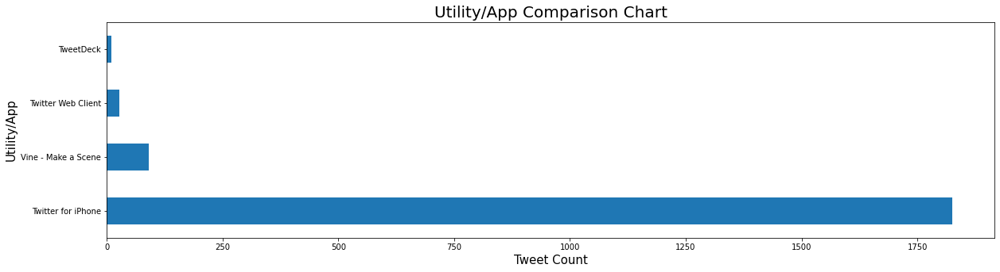

In [137]:
source_df['source'].value_counts().plot(kind = 'barh', figsize = (20,5))
plt.title('Utility/App Comparison Chart', fontsize = 20)
plt.xlabel('Tweet Count', fontsize = 15)
plt.ylabel('Utility/App', fontsize = 15)

<a id='insight2'></a>
### Insight#2: Retweet and Like Stats By Dog Breeds
*This shows the relationship or comparison of total retweets and likes for each dog breed. The highest mark goes to 'unknown' dog breed as there are many tweets that don't mention the breed and some were not accurately classified by the neural network.*


*Golden Retriever has the highest bars which has total retweets of 586657 and total likes of 1943782*

In [138]:
df.groupby(['dog_breed'])[['retweet_count', 'favorite_count']].agg(['sum']).reset_index()[20:30]
                                                                                    

,dog_breed,retweet_count,favorite_count
,,sum,sum
20,Brabancon_griffon,863.0,2655.0
21,Briard,8900.0,28535.0
22,Brittany_spaniel,10870.0,43019.0
23,Bull_mastiff,7436.0,30326.0
24,Cairn,3391.0,16330.0
25,Cardigan,79765.0,269644.0
26,Chesapeake_bay_retriever,81730.0,302246.0
27,Chihuahua,250722.0,743689.0
28,Chow,131025.0,446933.0


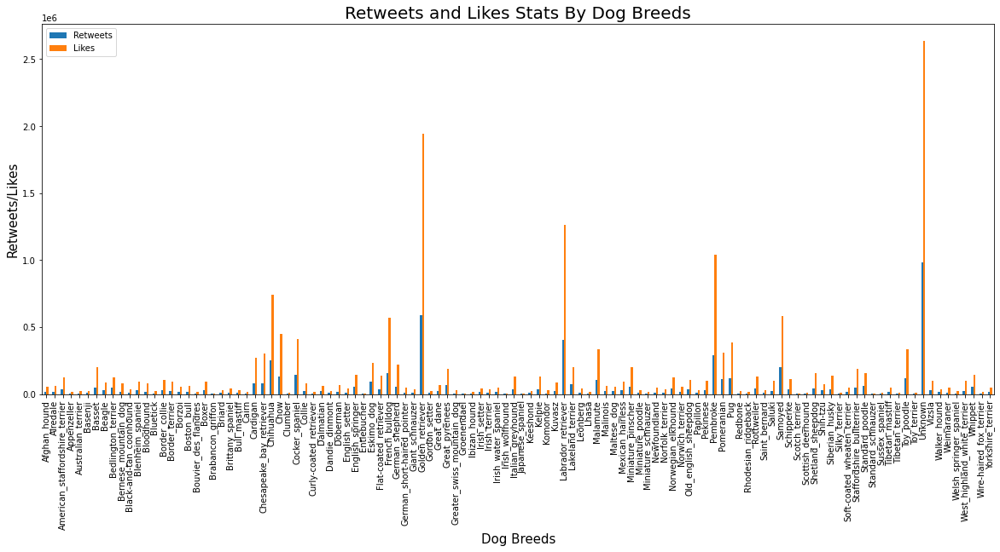

In [139]:
df.groupby(['dog_breed'])[['retweet_count', 'favorite_count']].agg(['sum']).plot(kind = 'bar', figsize = (20,8))
plt.title('Retweets and Likes Stats By Dog Breeds', fontsize = 20)
plt.xlabel('Dog Breeds', fontsize = 15)
plt.ylabel('Retweets/Likes', fontsize = 15)
plt.legend(["Retweets", "Likes"]);

<a id='insight3'></a>
### Insight#3: Retweet and Like Stats By Dog Stages
*This shows the relationship or comparison of total retweets and likes for each dog stage.*

*Pupper has the longest bars with total retweets of 528234 and total likes of 1543210, followed by doggo which has total retweets of 466193 and total likes of 1272012.*

In [140]:
df.groupby(['dog_stage'])[['retweet_count', 'favorite_count']].agg(['sum'])[1:].reset_index()

,dog_stage,retweet_count,favorite_count
,,sum,sum
0,doggo,466193.0,1272012.0
1,"doggo, floofer",3433.0,17169.0
2,"doggo, pupper",35578.0,104997.0
3,"doggo, puppo",19196.0,47844.0
4,floofer,37403.0,99580.0
5,pupper,528776.0,1545089.0
6,puppo,151801.0,497319.0


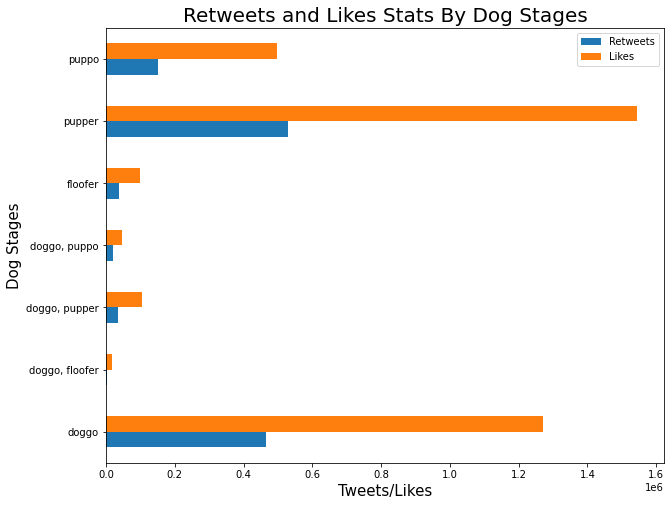

In [141]:
df.groupby(['dog_stage'])[['retweet_count', 'favorite_count']].agg(['sum'])[1:].plot(kind = 'barh', figsize = (10,8))
plt.title('Retweets and Likes Stats By Dog Stages', fontsize = 20)
plt.xlabel('Tweets/Likes', fontsize = 15)
plt.ylabel('Dog Stages', fontsize = 15)
plt.legend(["Retweets", "Likes"]);

<a id='insight4'></a>
### Insight#4: Top 20 Popular Dog Names. Charlie and Lucy share the top spot!


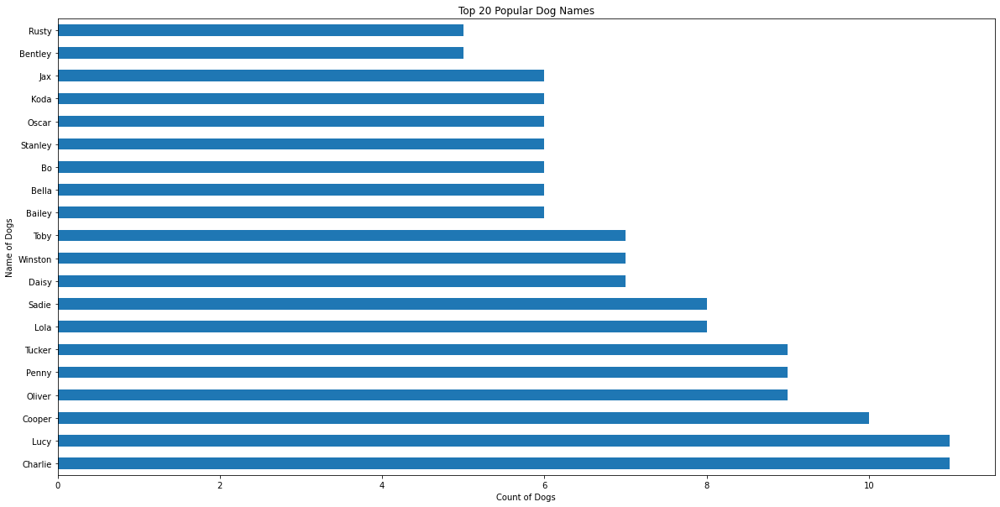

In [142]:
df['name'].value_counts()[1:21].plot(kind = 'barh', figsize = (20,10))
plt.title('Top 20 Popular Dog Names')
plt.xlabel('Count of Dogs')
plt.ylabel('Name of Dogs');

<a id='insight5'></a>
### Insight#5: Most Retweeted Tweet has 79515 total retweets.

In [143]:
retweet_df = df.groupby(['text','tweet_id', 'jpg_url']).retweet_count.sum().sort_values(ascending = False)[:1]
retweet_df = retweet_df.reset_index()
retweet_df

,text,tweet_id,jpg_url,retweet_count
0,Here's a doggo realizing you can stand in a po...,744234799360020481,https://pbs.twimg.com/ext_tw_video_thumb/74423...,79515.0


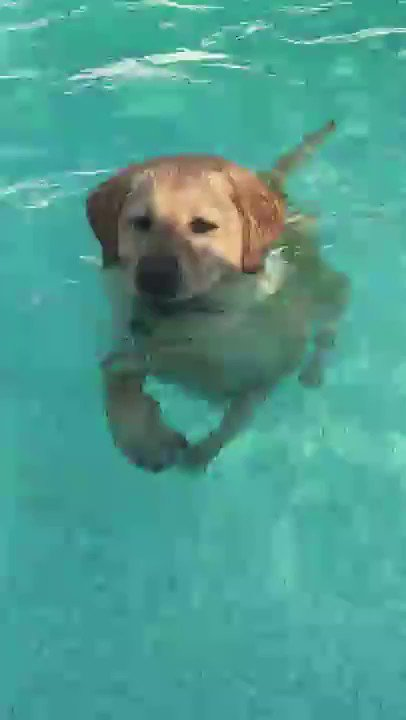

In [144]:
from IPython.core.display import display, HTML, Image
display(HTML("<b>Tweet: {}</b>" "<br>(Tweet ID: {})".format(retweet_df['text'].values[0], retweet_df.tweet_id.values[0])))
display(Image(retweet_df.jpg_url.values[0], width = 100))

<a id='insight6'></a>
### Insight#6: Most Liked Tweet has 132810 likes.

In [145]:
favorite_df = df.groupby(['text','tweet_id', 'jpg_url']).favorite_count.sum().sort_values(ascending = False)[:1]
favorite_df = favorite_df.reset_index()
favorite_df

,text,tweet_id,jpg_url,favorite_count
0,Here's a super supportive puppo participating ...,822872901745569793,https://pbs.twimg.com/media/C2tugXLXgAArJO4.jpg,132810.0


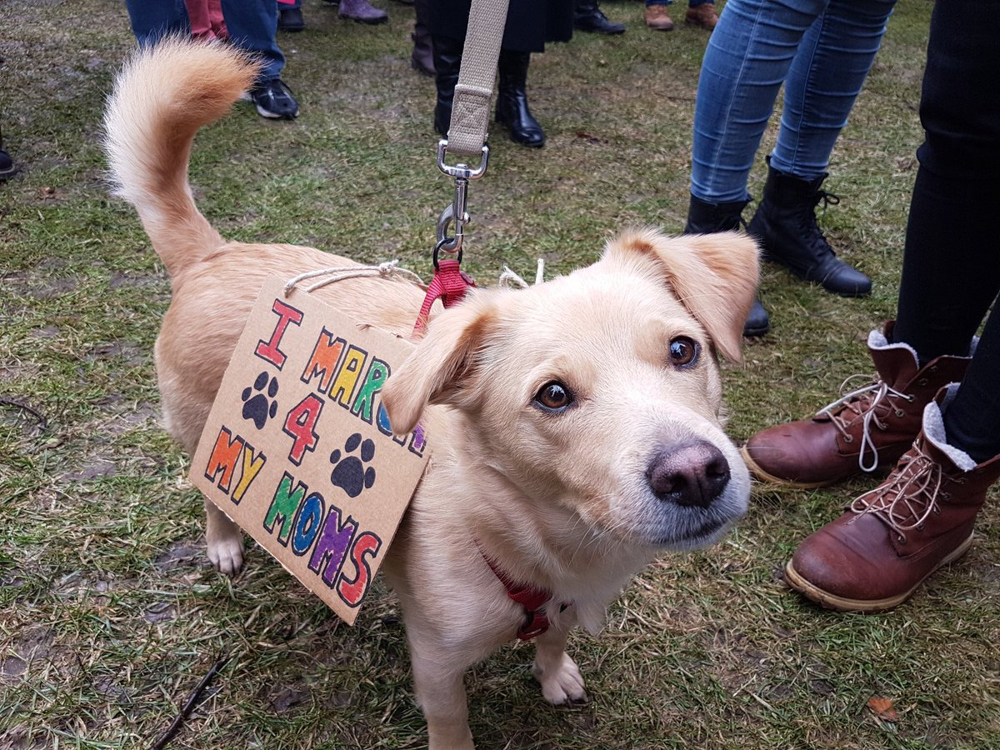

In [146]:
from IPython.core.display import display, HTML, Image
display(HTML("<b>Tweet: {}</b>" "<br>(Tweet ID: {})".format(favorite_df['text'].values[0], favorite_df.tweet_id.values[0])))
display(Image(favorite_df.jpg_url.values[0], width = 100))

<a id='insight7'></a>
### Insight#7: Average ratings per dog stage are almost equally distributed. 
*Multiple dog stage doggo,puppo got the highest average rating of 1.3*

In [147]:
df.groupby('dog_stage')['dog_rating'].mean().sort_values()

dog_stage
None              1.078871
pupper            1.094033
doggo, floofer    1.100000
doggo, pupper     1.125000
floofer           1.188889
doggo             1.191304
puppo             1.200000
doggo, puppo      1.300000
Name: dog_rating, dtype: float64

Text(0, 0.5, 'Dog Stage')

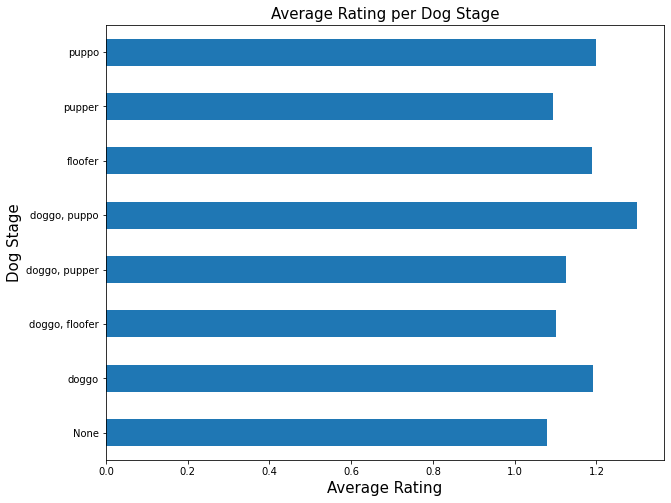

In [148]:
df.groupby('dog_stage')['dog_rating'].mean().plot(kind = 'barh', figsize = (10,8))
plt.title('Average Rating per Dog Stage', fontsize=15)
plt.xlabel('Average Rating', fontsize=15)
plt.ylabel('Dog Stage', fontsize=15)

<a id='insight8'></a>
### Insight#8: Top 20 dog breeds with the highest average ratings
*Dog breed Bouvier_des_flandres got the top spot with average rating of 1.3*

In [149]:
df.groupby('dog_breed')['dog_rating'].mean().sort_values(ascending=False)[:20]

dog_breed
Bouvier_des_flandres       1.300000
Saluki                     1.250000
Briard                     1.233333
Tibetan_mastiff            1.225000
Border_terrier             1.214286
Standard_schnauzer         1.200000
Silky_terrier              1.200000
Gordon_setter              1.175000
Irish_setter               1.175000
Samoyed                    1.169048
Wire-haired_fox_terrier    1.150000
Australian_terrier         1.150000
Golden_retriever           1.149359
Great_pyrenees             1.146667
Pembroke                   1.142553
Chow                       1.141667
Eskimo_dog                 1.140909
Doberman                   1.133333
Leonberg                   1.133333
Irish_water_spaniel        1.133333
Name: dog_rating, dtype: float64

Text(0, 0.5, 'Dog Breed')

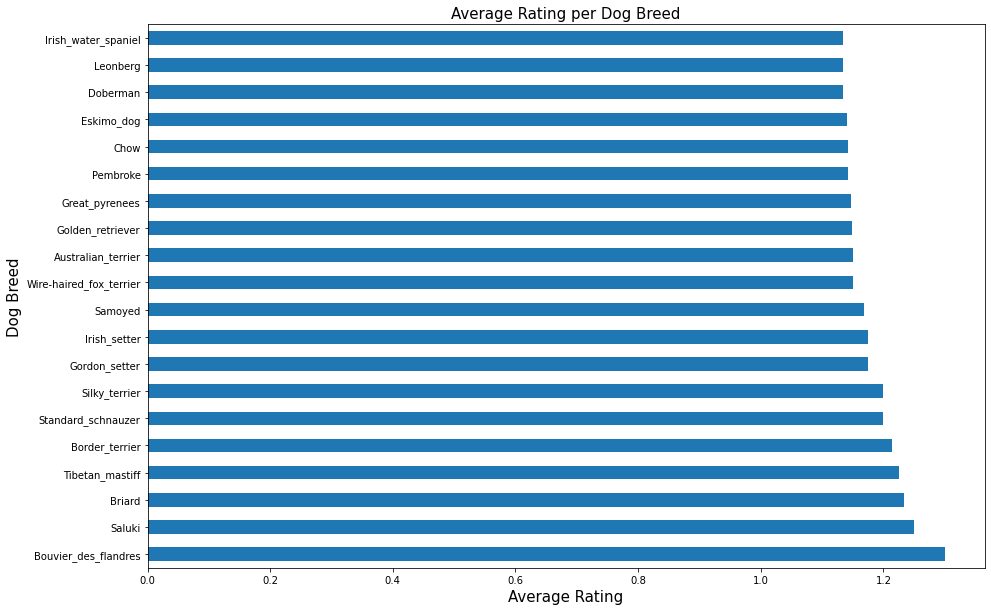

In [150]:
df.groupby('dog_breed')['dog_rating'].mean().sort_values(ascending=False)[:20].plot(kind = 'barh', figsize = (15,10))
plt.title('Average Rating per Dog Breed', fontsize=15)
plt.xlabel('Average Rating', fontsize=15)
plt.ylabel('Dog Breed', fontsize=15)

<a id='insight9'></a>
### Insight#9: Dog Stages Pie Chart
*Those dogs without dog stages were excluded for the purpose of this visualization. For those dogs that have dog stages, pupper is the most common among them*

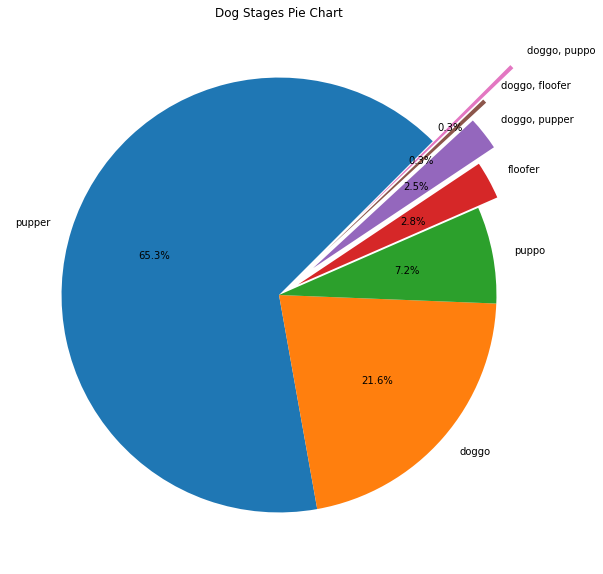

In [151]:
dog_stage = df['dog_stage'].value_counts().sort_values(ascending=False)[1:].plot(kind = 'pie', figsize = (10,10), autopct='%1.1f%%', \
                                                                                 explode=[0,0,0,.1,.2,.3,.5], startangle=45)
plt.title('Dog Stages Pie Chart')
plt.ylabel('');


<a id='insight10'></a>
### Insight#10: Retweets and Likes Correlation per Rating
*It appears that the higher the rating of the dogs, the more likes and retweets they get.*

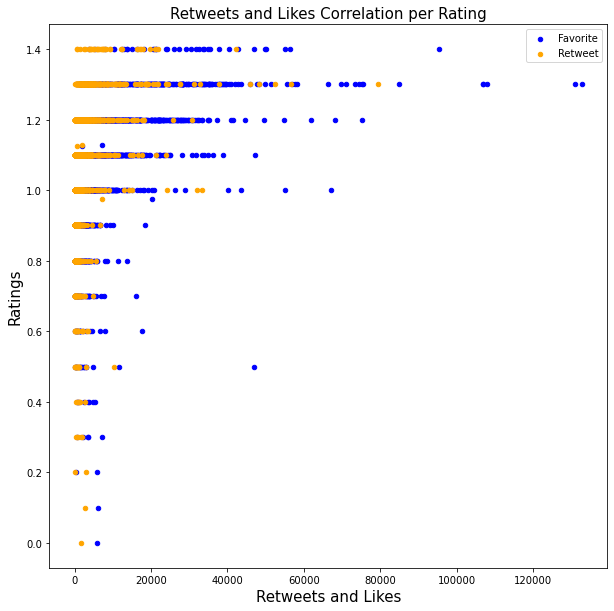

In [152]:
favorite = df.plot(kind='scatter', y='dog_rating', x='favorite_count', color='blue')    
retweet = df.plot(kind='scatter', y='dog_rating', x='retweet_count', color='orange', ax=favorite)    
plt.title("Retweets and Likes Correlation per Rating", size=15)
plt.xlabel("Retweets and Likes", size=15)
plt.ylabel("Ratings", size=15)
plt.legend(["Favorite", "Retweet"])
plt.gcf().set_size_inches((10, 10));